In [2]:
import casadi as cs
import numpy as np
import matplotlib.pyplot as plt
import sys
import functools

loc = 'alien-windows'
if loc == 'alien-windows':
    src_root = "C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\"
else:
    raise AssertionError
    
if src_root not in sys.path:
    sys.path.append(src_root)
print(sys.path)
%load_ext autoreload
%autoreload 2

from ds_utils import utils as ds_utils
from models import utils as models
from models import gp_wrappers as gp_wrappers
from smpc import utils as smpc
from smpc import controller_utils as controller
from sys_dyn import problem_setups
from sys_dyn import nlsys_utils as nlsys_utils
from smpc import rt_hgpmpc as rt_hgpmpc
from smpc import full_example_setup as full_example_setup
from mapping import example as hm_mapping
from mapping import nn_map
from exploration_opt import utils as exploration_utils
from exploration_opt import simd_annealing
from common import data_save_utils
from incremental_controller_impls import examples
from incremental_controller_impls import minlp_examples

['C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\ipynb_tests', 'C:\\Program Files\\Python38\\python38.zip', 'C:\\Program Files\\Python38\\DLLs', 'C:\\Program Files\\Python38\\lib', 'C:\\Program Files\\Python38', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv', '', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages\\win32', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages\\win32\\lib', 'C:\\Users\\l8souza\\PycharmProjects\\GP4MPC\\venv\\lib\\site-packages\\Pythonwin', 'C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\']


`polytope` failed to import `cvxopt.glpk`.
will use `scipy.optimize.linprog`


# Interior Tracking results

## Trajectory to track

[[0 1 0 0]]
[[1]
 [0]]
Lower bound: [[ 0.  ]
 [-0.05]], Upper bound: [[4]
 [4]]
Lower bound: [[-5.]
 [-5.]], Upper bound: [[5.]
 [5.]]
Nominal MPC traj to warmstart and track solved.
[[ 4.99998  4.99999  4.99996  5.       5.       0.56401 -2.7563  -3.34353
  -3.48966 -3.47256 -3.51109 -3.49034 -3.49223 -3.49875 -3.45169 -3.46634
  -3.51317 -3.48474 -3.51888 -3.43791 -3.61162 -3.50719 -3.51142 -3.48874
  -3.50575 -3.4201  -3.55293 -3.52707 -3.50287 -3.48329 -3.49196 -3.4893
  -3.49873 -3.51113 -3.50971 -3.50615 -3.49043 -3.48525 -3.44192 -3.44804
  -3.54085 -3.72584 -4.41495 -4.99989 -4.99993 -4.99999 -4.99997 -5.
  -4.99999 -5.      -5.      -4.99999 -4.99998 -3.15522 -1.04183 -0.59517
  -0.51129 -0.52204 -0.5091  -0.51318 -0.51463 -0.51406 -0.48979 -0.52187
  -0.51205 -0.49354 -0.51622 -0.49022 -0.50712 -0.52931 -0.37384 -0.45574
  -0.71691 -1.2985  -3.00793 -0.66191 -0.22325 -0.16508 -0.14414 -0.10631
  -0.10961 -0.10239 -0.09859 -0.09876 -0.09873 -0.0987  -0.09868 -0.09868
  -0.0986

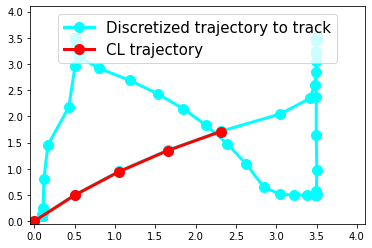

In [58]:
Q_override = np.eye(2)*50
examples.sanity_check_controller(x_init=np.zeros((2, 1)), N=100, closed_loop=True, num_discrete=100, simulation_length=100, velocity_override=5,
                                 early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                                 x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                                 waypoint_arr=((3.5, 3.5), (3.5, 0.5), (0.5, 3.5), (0.1, 0.1)), simulation_length_override=5,
                                 problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                                 online_N=30)

## NLP-Endo Controller tests

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.1632  4.99938] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.37624 4.99935] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.01631 4.99969] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.6056 4.9998] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.19355 4.99981] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [1.07224 4.99897] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-1.29075  4.9997 ] Solving for timestep: 7
t: 7, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-2.56342  4.99986] Solving for timestep: 8
t: 8, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-3.46922  4.98163] Solving for timestep: 9

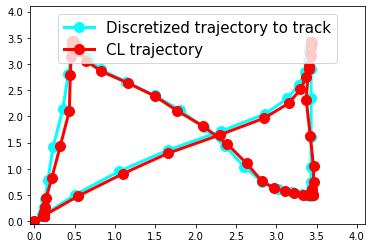

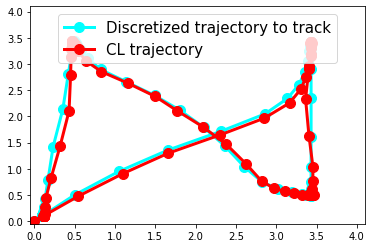

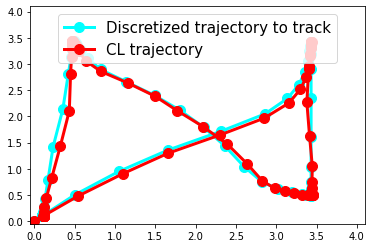

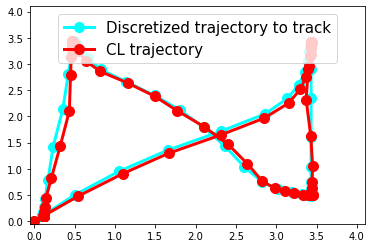

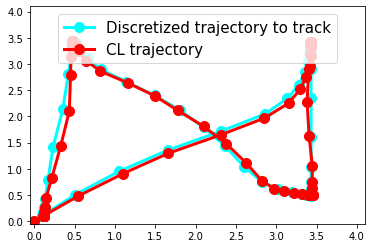

...

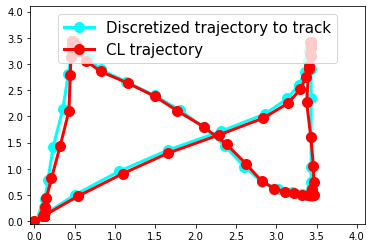

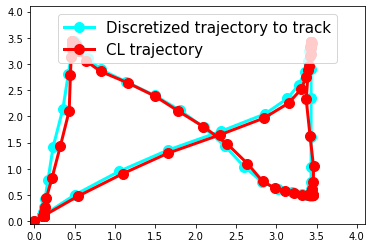

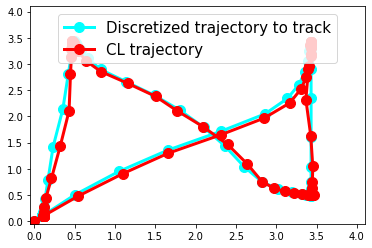

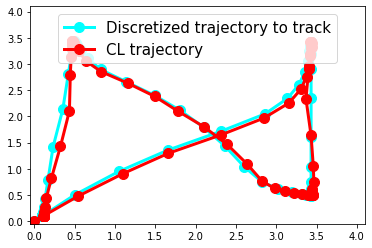

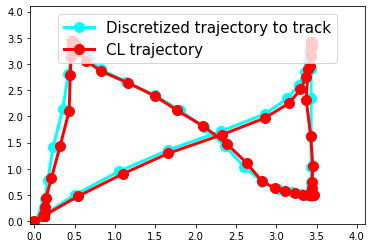

In [30]:
Q_override=np.eye(2)*50
examples.gpmpc_D_controller_multiple(gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                             Q_override=Q_override,
                                      num_multiple=50, data_save_file="final_lti_C_runs_dt100msN100disc100xz4_interiortrack")

[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
129
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.11953 4.99908] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.19165 4.99508] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.16253 4.9981 ] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.64623 4.99909] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.28636 4.99994] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [1.00298 4.99955] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-1.27169  4.99989] Solving for timestep: 7
t: 7, Ret. stat.: Solved_T

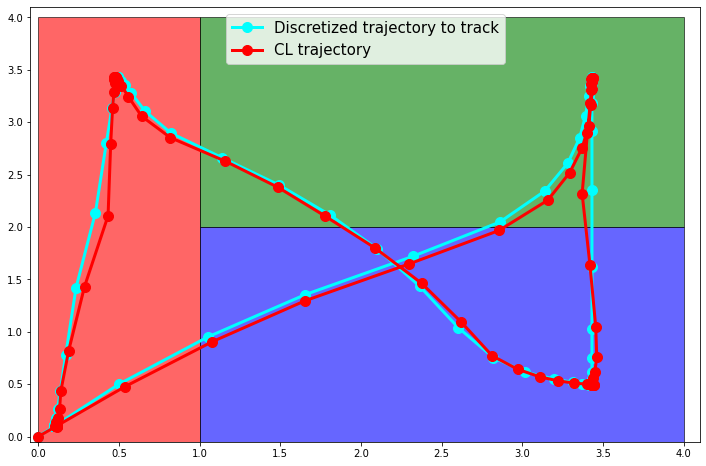

In [53]:
Q_override=np.eye(2)*50
examples.gpmpc_D_controller(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                             Q_override=Q_override)

## NLP-Exo Controller Tests

[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
129
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.29713 4.98197] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.31236 4.9891 ] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.36541 4.99935] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.54082 4.98908] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.06325 4.9925 ] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.94395 4.99657] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-1.47099  4.99715] Solving for timestep: 7
t: 7, Ret. stat.: Solved_T

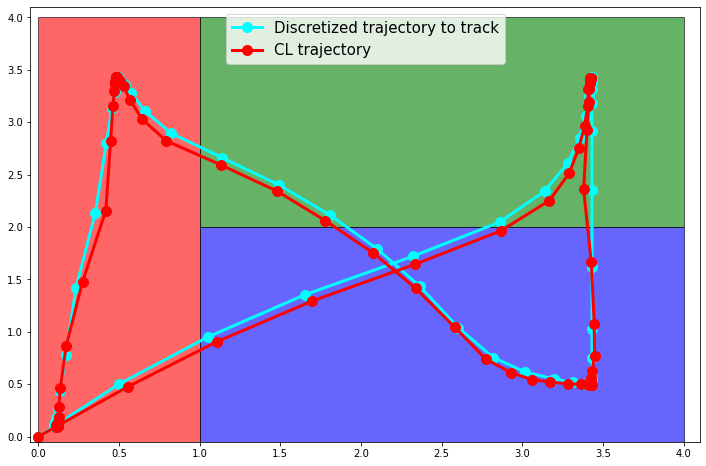

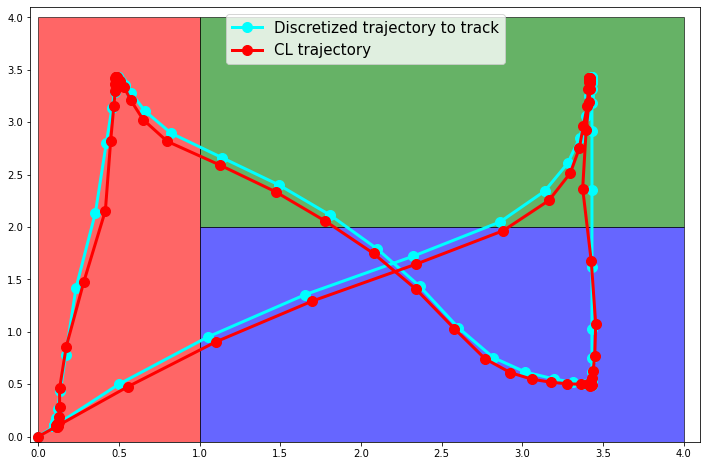

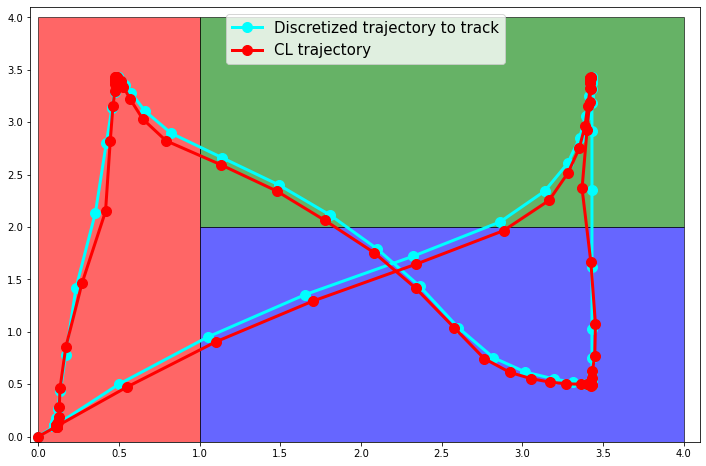

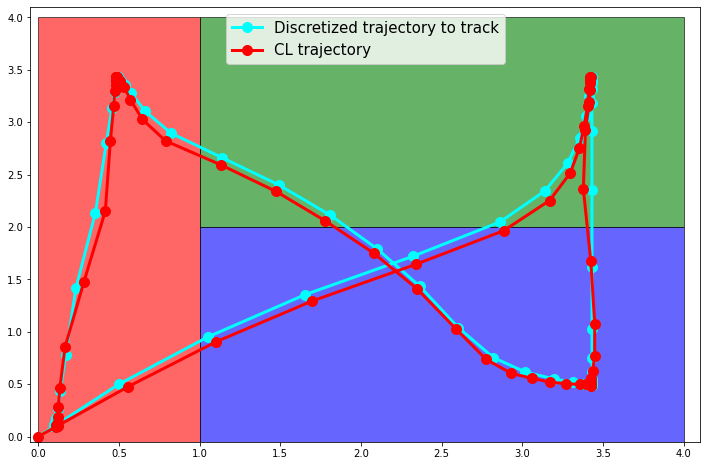

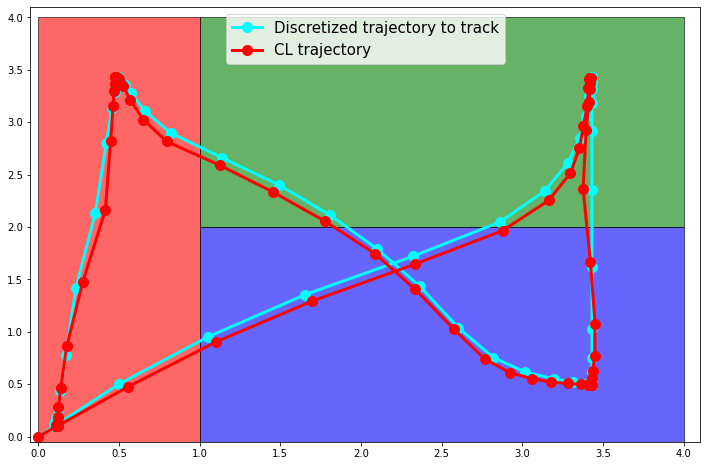

...

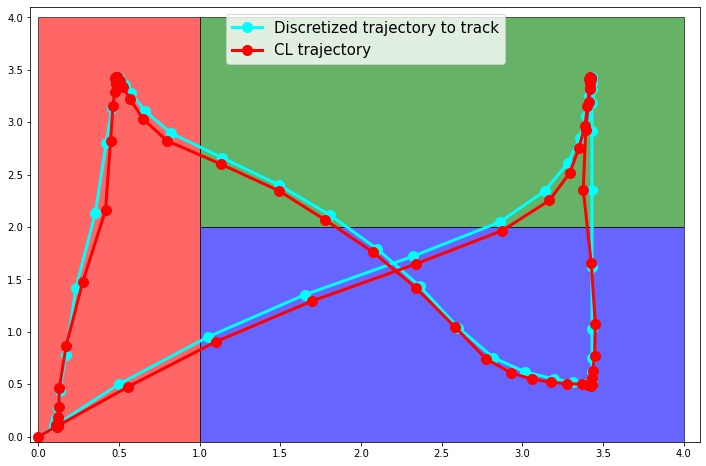

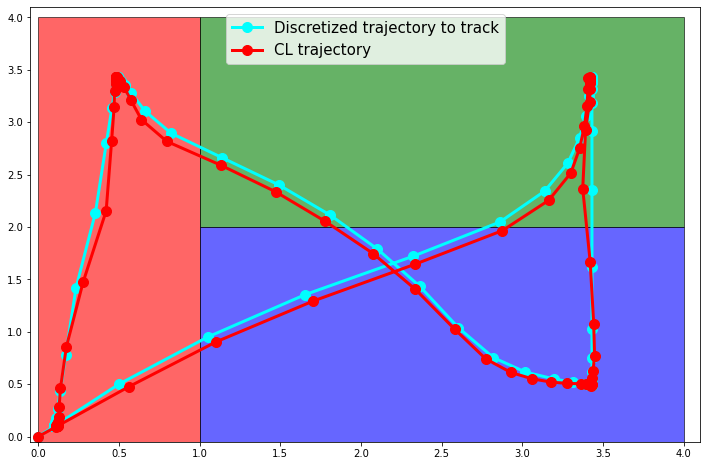

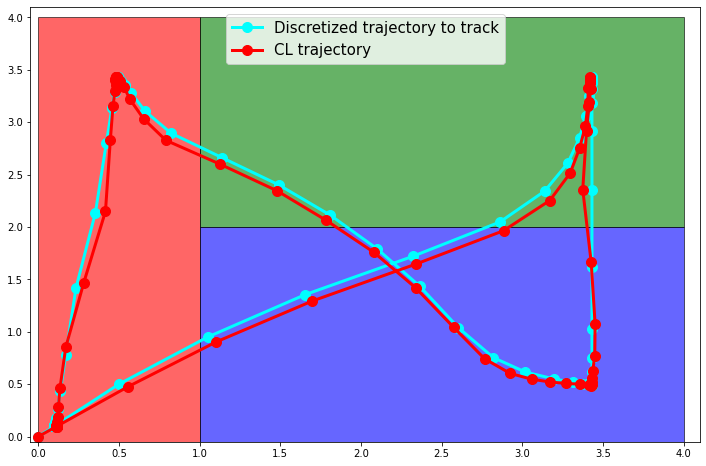

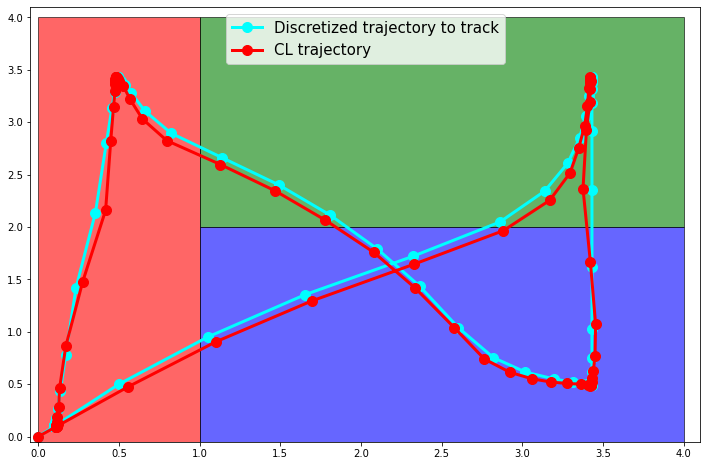

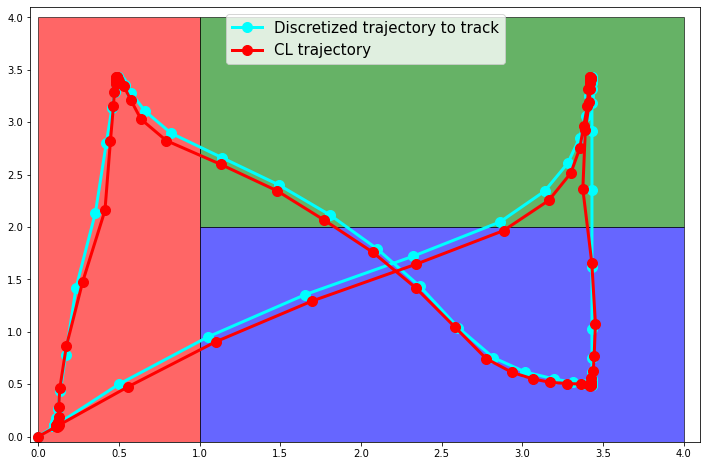

In [39]:
Q_override=np.eye(2)*50
examples.gpmpc_QP_controller_multiple(satisfaction_prob=0.99,gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                             Q_override=Q_override, num_multiple=50, data_save_file="final_lti_QP_runs_dt100msN100disc100xz4_interiortrack")

[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
129
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.29713 4.98197] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.27701 4.99134] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.35222 4.99976] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.54201 4.99945] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.09433 4.99382] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [0.77458 4.99799] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-1.47529  4.99637] Solving for timestep: 7
t: 7, Ret. stat.: Solved_T

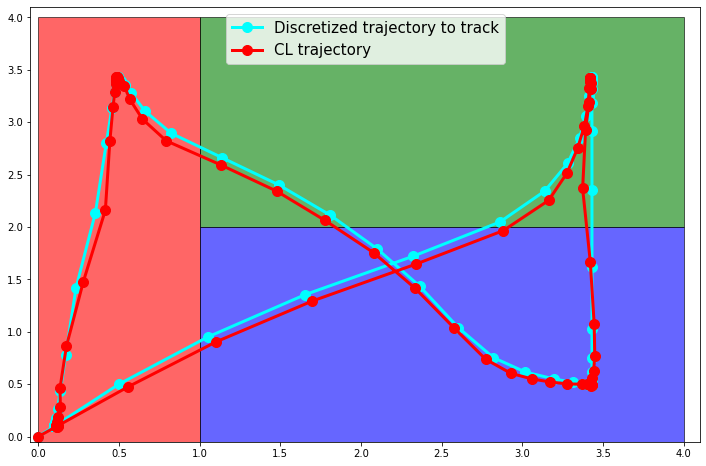

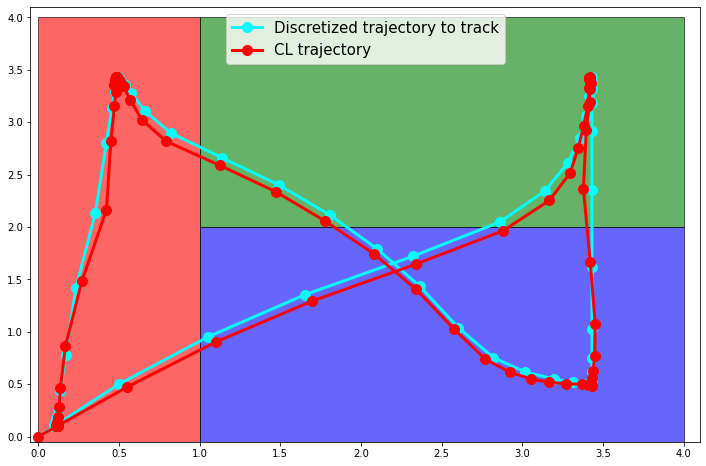

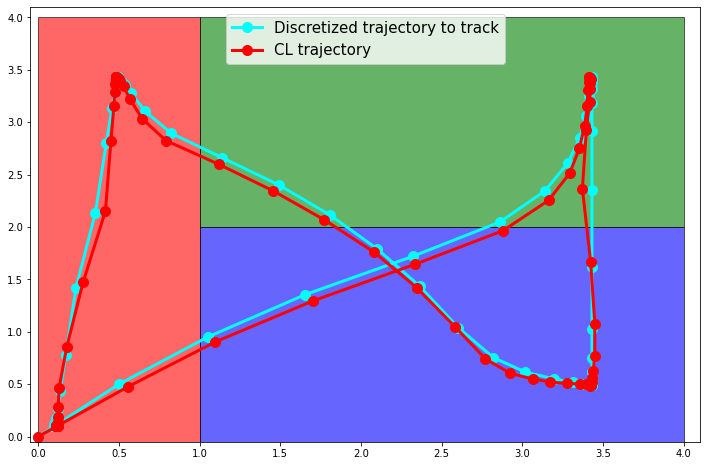

In [38]:
Q_override=np.eye(2)*50
for i in range(3):
    examples.gpmpc_QP_controller(satisfaction_prob=0.99,gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                                 num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                                 ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                                 early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                                 x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                                 waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                                 problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                                 integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                                 Q_override=Q_override)

In [11]:
import pickle as pkl
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"QP_runs_lti_dt100msN100disc100xz4_interiortrack"+".pkl", 'rb') as f:
    data = pkl.load(f)
print([run_data["cl_cost"] for run_data in data])

[array([[45.90996]]), array([[46.81648]]), array([[47.38018]]), array([[46.50528]])]


## MINLP Controller Tests (N=6)

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
[[0.      0.5     1.05    1.655   2.3205  2.86102 3.13895 3.28143 3.35462
  3.39221 3.4115  3.42085 3.42599 3.42797 3.42954 3.43008 3.43084 3.43131
  3.43175 3.43158 3.43124 3.43114 3.4314  3.43167 3.43176 3.43226 3.4322
  3.43262 3.43259 3.43236 3.43235 3.43233 3.43231 3.43216 3.43173 3.43131
  3.43088 3.42894 3.42659 3.42333 3.41616 3.40261 3.37247 3.31366 3.19937
  3.01931 2.82124 2.60337 2.3637  2.10007 1.81008 1.49109 1.1402  0.82313
  0.66161 0.57771 0.53533 0.51355 0.50186 0.49623 0.49371 0.49256 0.49178
  0.49121 0.49043 0.49001 0.48981 0.48806 0.48747 0.48615 0.48201 0.47377
  0.45713 0.42207 0.35407 0.2343  0.16996 0.13627 0.11933 0.10947 0.10412
  0.10098 0.09931 0.09815 0.09704 0.09652 0.09627 0.09616 0.09611 0.09609
  0.09608 0.09608 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0

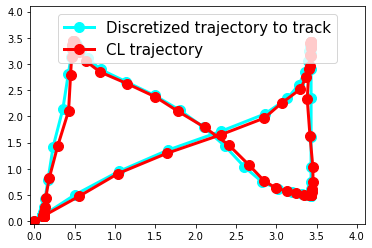

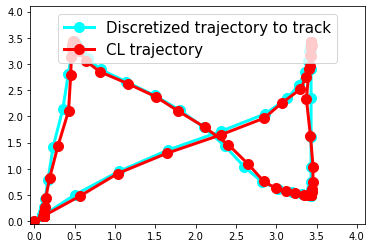

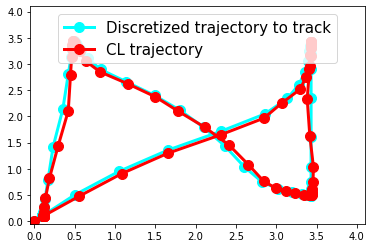

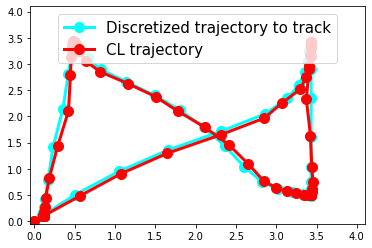

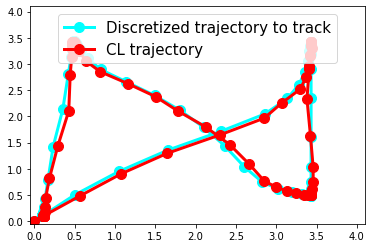

...

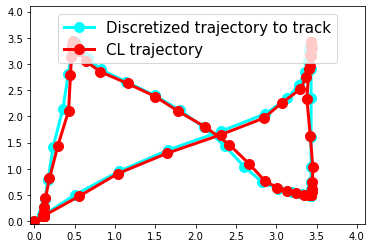

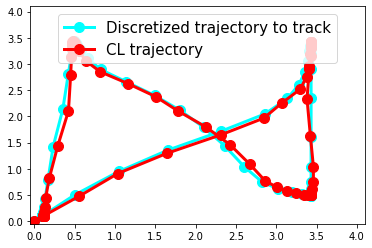

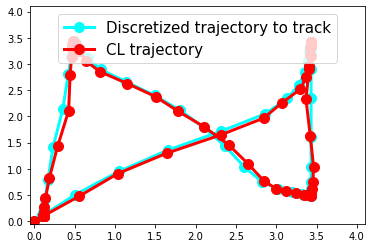

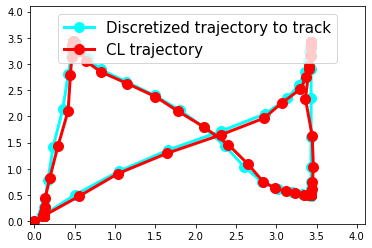

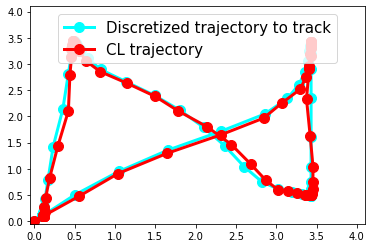

In [28]:
Q_override=np.eye(2)*50
minlp_examples.gpmpc_MINLP_controller_C_multiple(satisfaction_prob=0.99,gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, periodic_callback_freq=1, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=6, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                             Q_override=Q_override, num_multiple=50, data_save_file="final_lti_MINLP_dt100msN100disc100xz4_interiortrack")

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
[[0.      0.5     1.05    1.655   2.3205  2.86102 3.13895 3.28143 3.35462
  3.39221 3.4115  3.42085 3.42599 3.42797 3.42954 3.43008 3.43084 3.43131
  3.43175 3.43158 3.43124 3.43114 3.4314  3.43167 3.43176 3.43226 3.4322
  3.43262 3.43259 3.43236 3.43235 3.43233 3.43231 3.43216 3.43173 3.43131
  3.43088 3.42894 3.42659 3.42333 3.41616 3.40261 3.37247 3.31366 3.19937
  3.01931 2.82124 2.60337 2.3637  2.10007 1.81008 1.49109 1.1402  0.82313
  0.66161 0.57771 0.53533 0.51355 0.50186 0.49623 0.49371 0.49256 0.49178
  0.49121 0.49043 0.49001 0.48981 0.48806 0.48747 0.48615 0.48201 0.47377
  0.45713 0.42207 0.35407 0.2343  0.16996 0.13627 0.11933 0.10947 0.10412
  0.10098 0.09931 0.09815 0.09704 0.09652 0.09627 0.09616 0.09611 0.09609
  0.09608 0.09608 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0

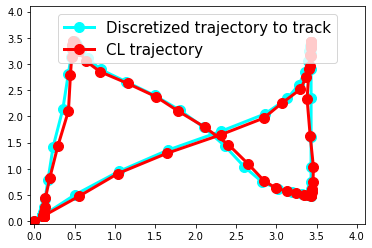

In [59]:
Q_override=np.eye(2)*50
minlp_examples.gpmpc_MINLP_controller_C(satisfaction_prob=0.99,gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, periodic_callback_freq=1, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=6, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                             Q_override=Q_override)

## MINLP Controller Tests (N=10)

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
[[0.      0.5     1.05    1.655   2.3205  2.86102 3.13895 3.28143 3.35462
  3.39221 3.4115  3.42085 3.42599 3.42797 3.42954 3.43008 3.43084 3.43131
  3.43175 3.43158 3.43124 3.43114 3.4314  3.43167 3.43176 3.43226 3.4322
  3.43262 3.43259 3.43236 3.43235 3.43233 3.43231 3.43216 3.43173 3.43131
  3.43088 3.42894 3.42659 3.42333 3.41616 3.40261 3.37247 3.31366 3.19937
  3.01931 2.82124 2.60337 2.3637  2.10007 1.81008 1.49109 1.1402  0.82313
  0.66161 0.57771 0.53533 0.51355 0.50186 0.49623 0.49371 0.49256 0.49178
  0.49121 0.49043 0.49001 0.48981 0.48806 0.48747 0.48615 0.48201 0.47377
  0.45713 0.42207 0.35407 0.2343  0.16996 0.13627 0.11933 0.10947 0.10412
  0.10098 0.09931 0.09815 0.09704 0.09652 0.09627 0.09616 0.09611 0.09609
  0.09608 0.09608 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0


KeyboardInterrupt



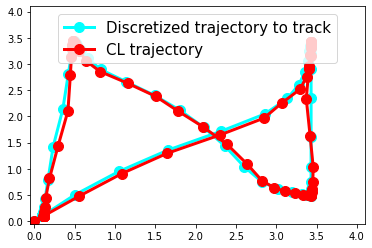

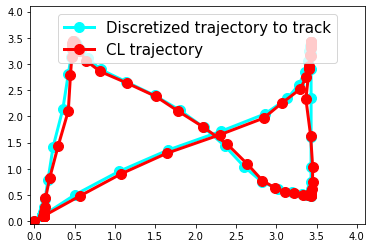

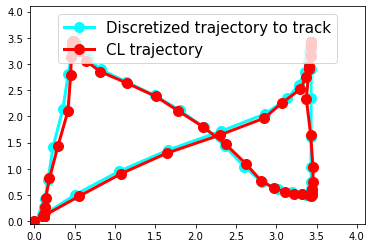

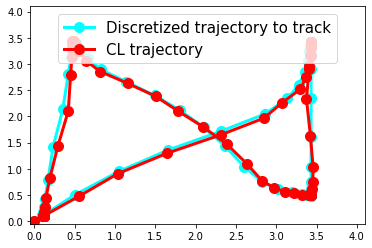

Error in callback <function flush_figures at 0x00000205E4D163A0> (for post_execute):



KeyboardInterrupt



In [60]:
Q_override=np.eye(2)*50
minlp_examples.gpmpc_MINLP_controller_C_multiple(satisfaction_prob=0.99,gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, periodic_callback_freq=1, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=10, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                             Q_override=Q_override, num_multiple=50, data_save_file="final_lti_MINLP_dt100msN100disc100xz4_interiortrack_onlineN10")

## Shrinking within optimization run-time example

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
[[0.      0.5     1.05    1.655   2.3205  2.86102 3.13895 3.28143 3.35462
  3.39221 3.4115  3.42085 3.42599 3.42797 3.42954 3.43008 3.43084 3.43131
  3.43175 3.43158 3.43124 3.43114 3.4314  3.43167 3.43176 3.43226 3.4322
  3.43262 3.43259 3.43236 3.43235 3.43233 3.43231 3.43216 3.43173 3.43131
  3.43088 3.42894 3.42659 3.42333 3.41616 3.40261 3.37247 3.31366 3.19937
  3.01931 2.82124 2.60337 2.3637  2.10007 1.81008 1.49109 1.1402  0.82313
  0.66161 0.57771 0.53533 0.51355 0.50186 0.49623 0.49371 0.49256 0.49178
  0.49121 0.49043 0.49001 0.48981 0.48806 0.48747 0.48615 0.48201 0.47377
  0.45713 0.42207 0.35407 0.2343  0.16996 0.13627 0.11933 0.10947 0.10412
  0.10098 0.09931 0.09815 0.09704 0.09652 0.09627 0.09616 0.09611 0.09609
  0.09608 0.09608 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607
  0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0.09607 0

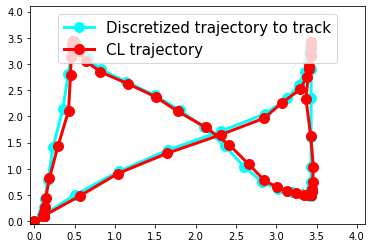

In [52]:
Q_override = np.eye(2)*50
minlp_examples.gpmpc_MINLP_controller_C(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=5, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0, periodic_callback_freq=1,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=6, read_desired_from_file="lti_dt100msN100disc100xz4_interiortrack",
                             Q_override=Q_override, shrink_by_param=False)

## Results

In [37]:
import pickle as pkl
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_lti_C_runs_dt100msN100disc100xz4_interiortrack"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))
print(np.mean([run_data["average_run_time"] for run_data in data]))

50
27.403601283750458
0.12743015545937042
0.0841042866


In [29]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_lti_MINLP_dt100msN100disc100xz4_interiortrack"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))
print(np.mean([run_data["average_run_time"] for run_data in data]))

50
26.39679467769897
0.13606804469688846
2.0025803142000003


In [40]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_lti_QP_runs_dt100msN100disc100xz4_interiortrack"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))
print(np.mean([run_data["average_run_time"] for run_data in data]))

50
30.04181348065744
0.21936730587251077
0.025252056399999997


In [61]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_lti_MINLP_dt100msN100disc100xz4_interiortrack_onlineN10"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))
print(np.mean([run_data["average_run_time"] for run_data in data]))

31
26.609310015976238
0.07832314327384979
6.430137248064517


# Boundary tracking results

## Res mean w/o shrinking controller

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.11764 0.07199] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 4.17825 -0.01625] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.88446 0.02385] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.80503 -0.00857] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.8388  0.02465] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.60789 -0.0612 ] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-3.42237  0.02435] Solving for timestep: 7
t: 7, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-4.80717 -0.08456] Solving for timestep: 8
t: 8, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-4.86379 -0.03506] Solving for tim

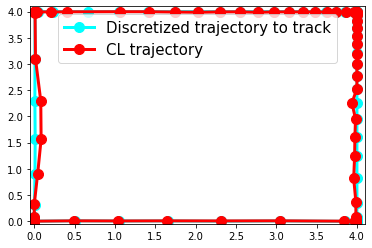

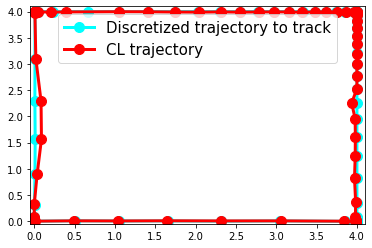

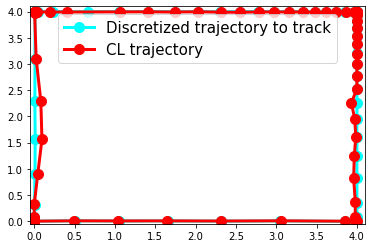

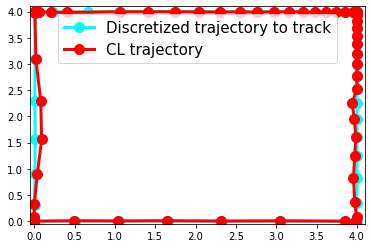

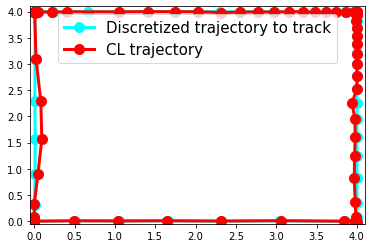

...

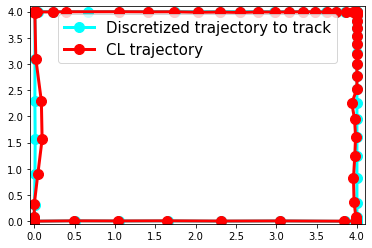

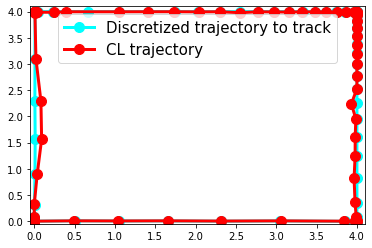

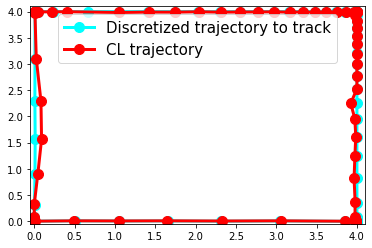

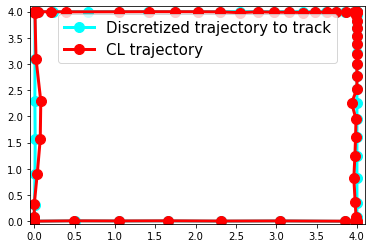

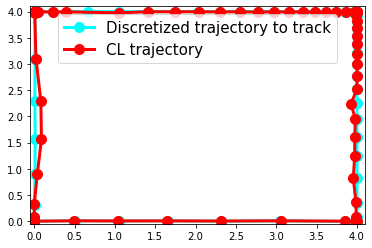

In [55]:
Q_override = np.eye(2)*50
R_override = np.eye(2)*0.01
examples.gpmpc_BnC_controller_multiple(gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=30, data_save_file="final_B_lti_runs_dt100msN100disc100xz4_edgetrack")

## Res mean + shrinking (NLP) controller

### px = 0.99

[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
129
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.10947 0.10616] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 4.11376 -0.02046] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.88857 0.02724] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.76003 -0.06524] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.88435 0.07305] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.44526 -0.06407] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-3.95801 -0.01463] Solving for timestep: 7
t: 7, Ret. stat.: So

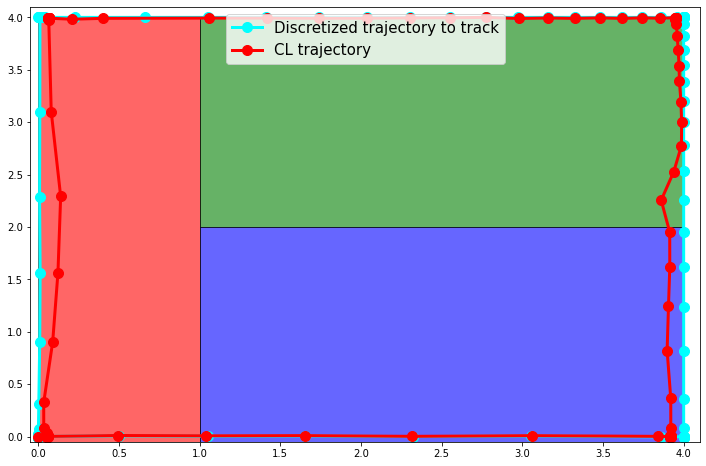

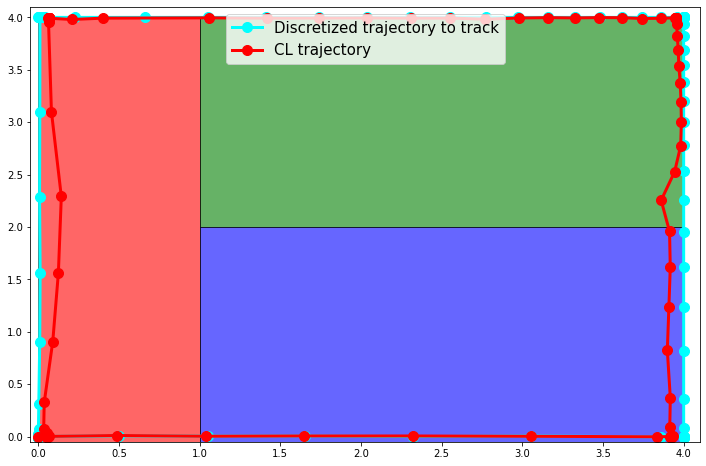

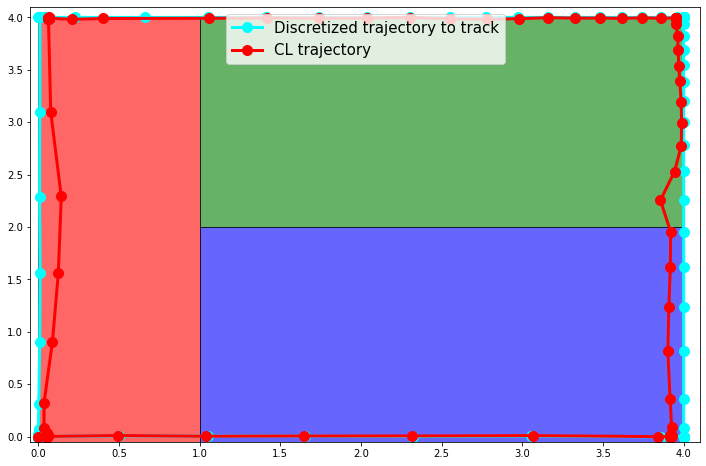

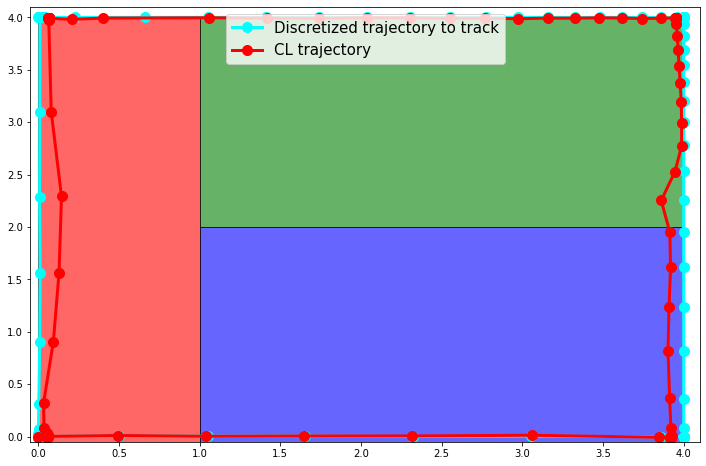

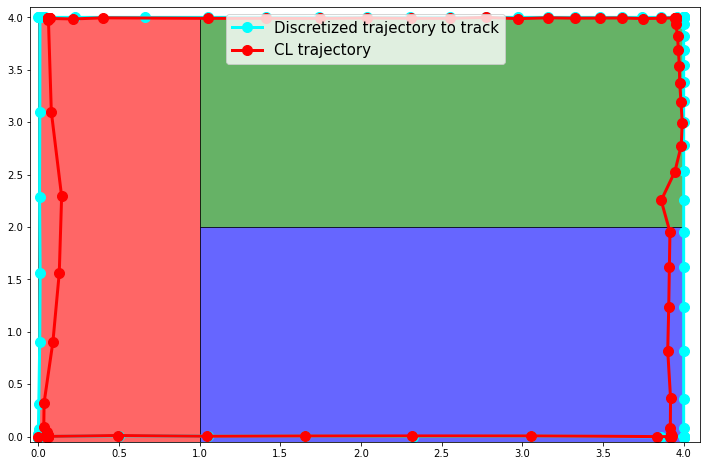

...

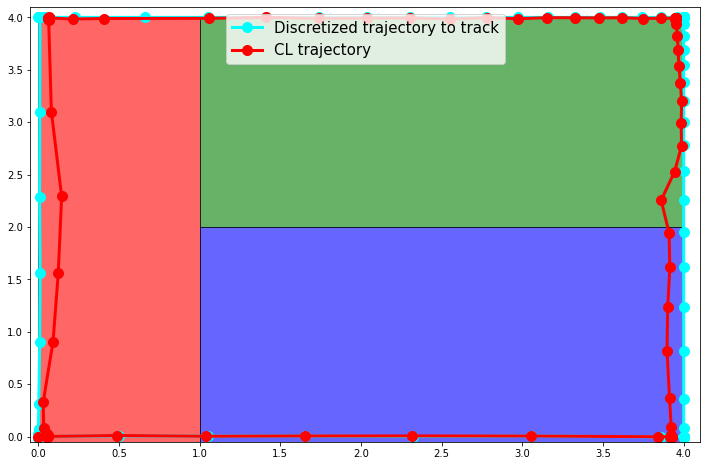

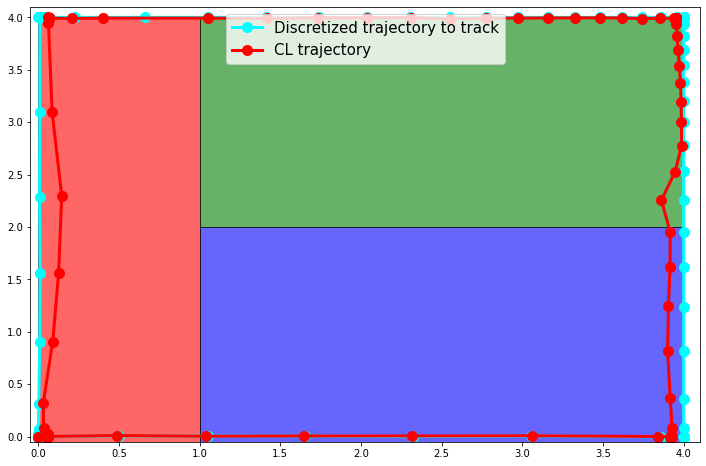

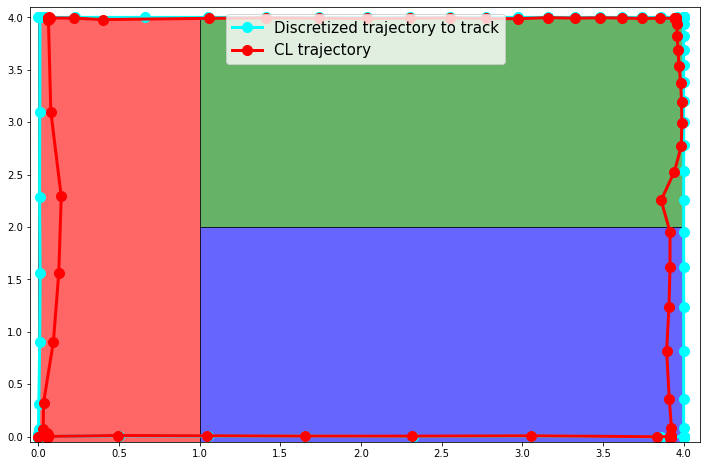

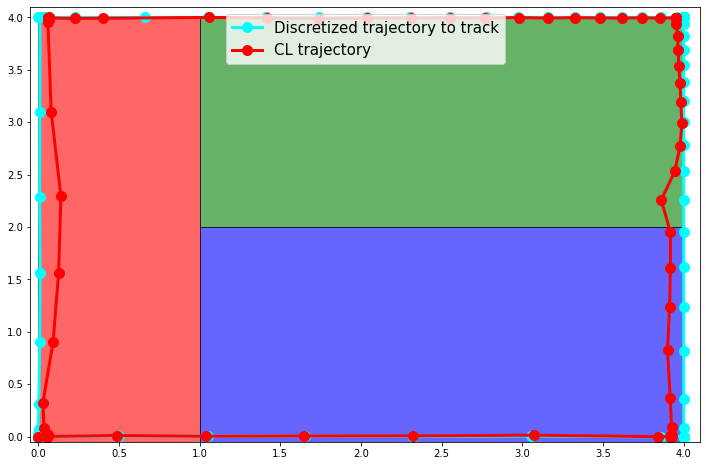

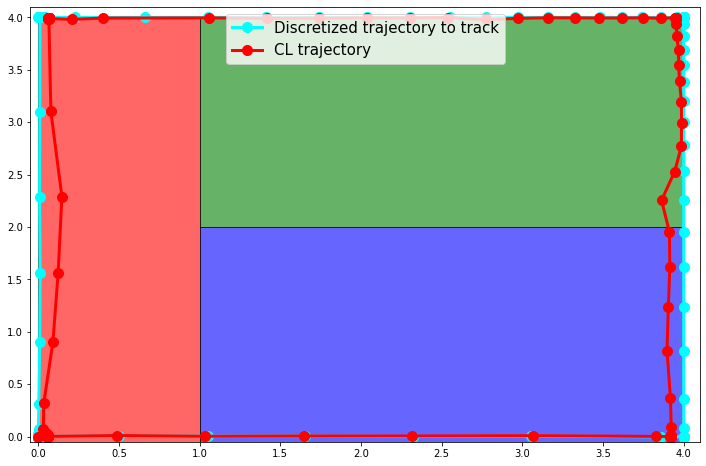

In [56]:
Q_override = np.eye(2)*50
R_override = np.eye(2)*0.01
examples.gpmpc_D_controller_multiple(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=30, data_save_file="final_D_lti_runs_dt100msN100disc100xz4_edgetrack_px99")

### px = 0.9

[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
129
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.13502 0.11366] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.13923 0.01096] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.87328 -0.00966] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.77773 -0.04657] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.79025 0.10825] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.44742 -0.12887] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-3.72428 -0.01423] Solving for timestep: 7
t: 7, Ret. stat.: So

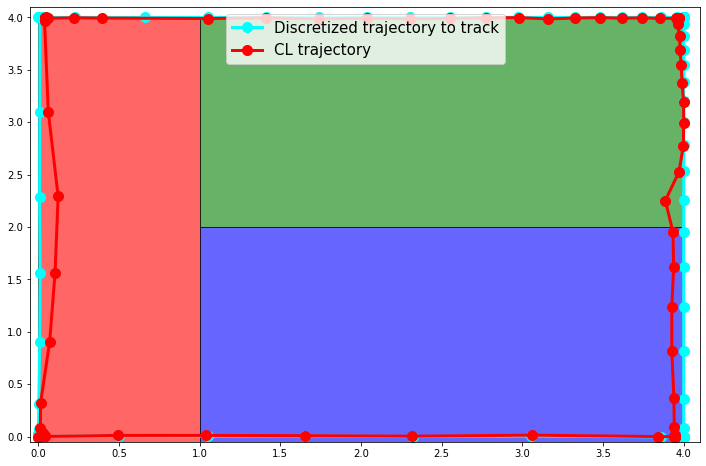

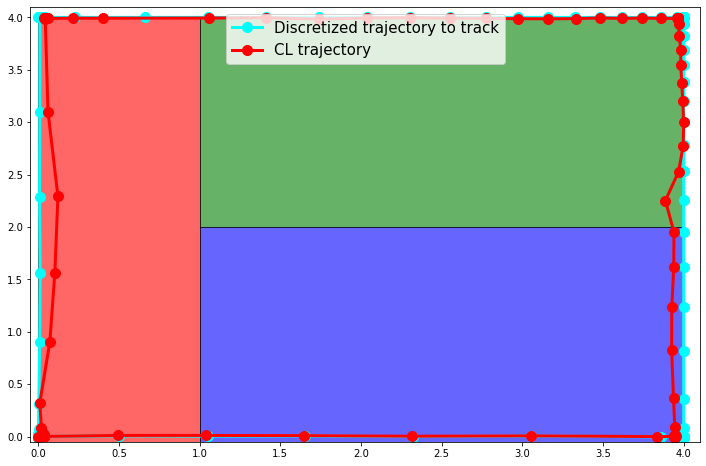

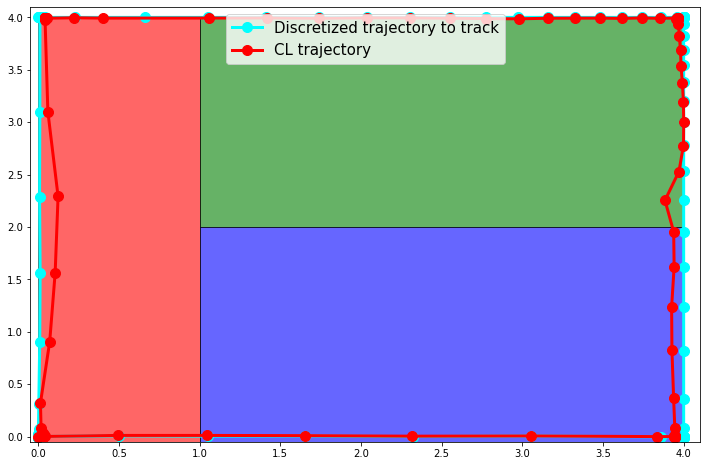

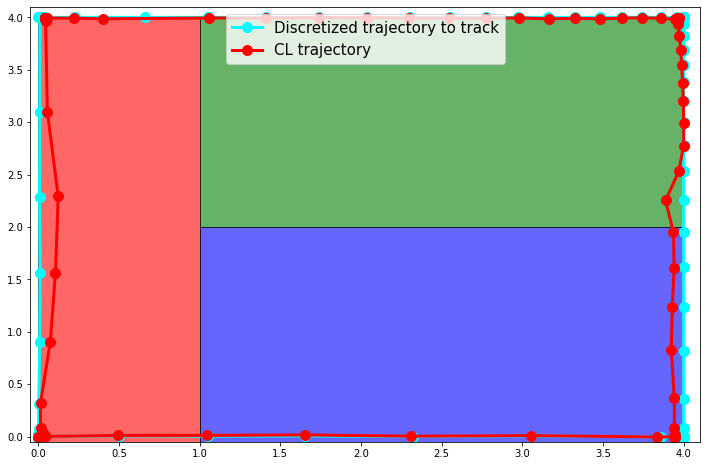

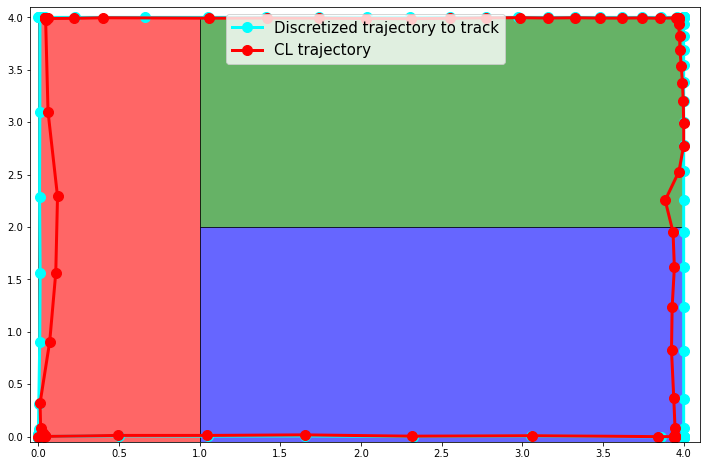

...

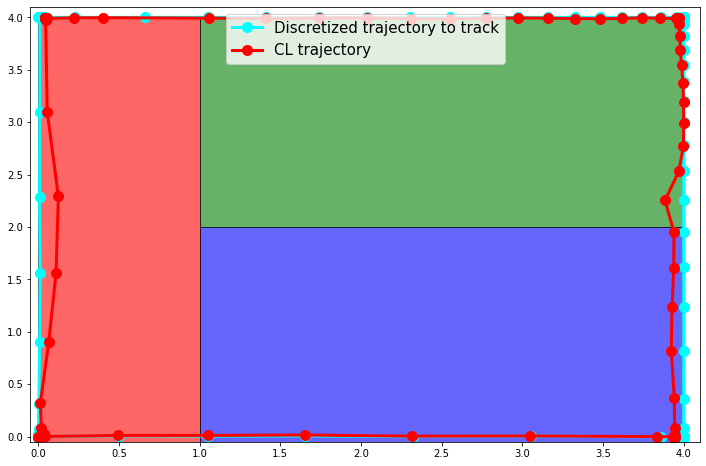

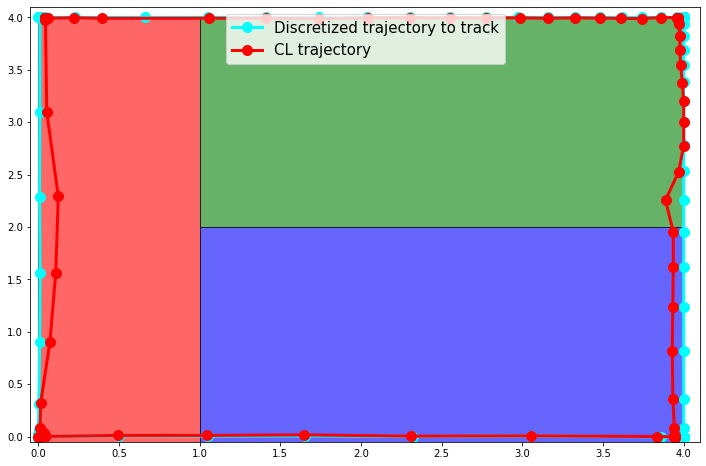

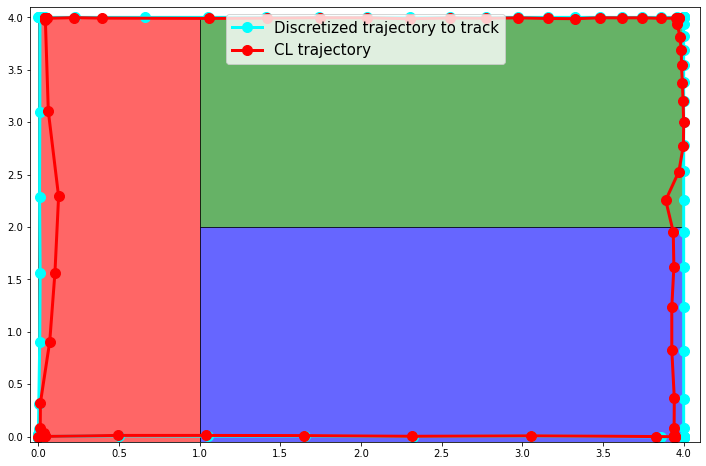

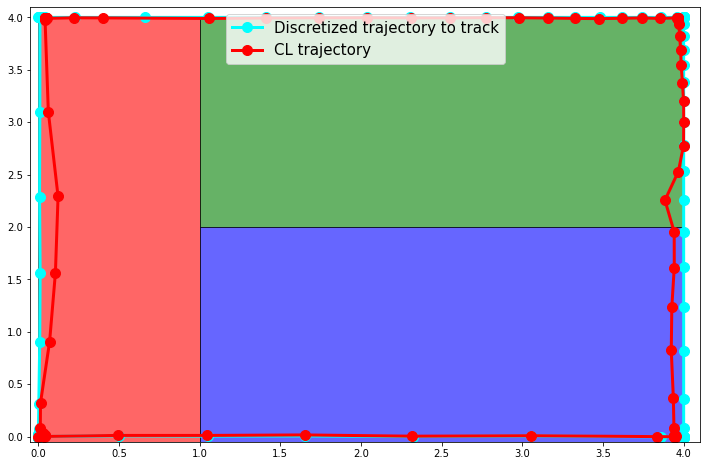

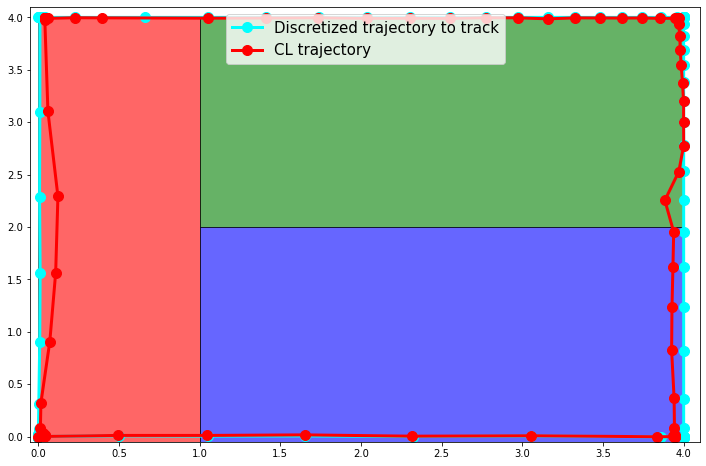

In [57]:
examples.gpmpc_D_controller_multiple(satisfaction_prob=0.9, gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=30, data_save_file="final_D_lti_runs_dt100msN100disc100xz4_edgetrack_px9")

## Affine res mean + shrinking (NLP-Endo) controller

### px = 0.99

[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
129
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.34737 0.07624] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 4.09548 -0.00689] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.86499 -0.03323] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.84333 -0.03173] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.03378 0.14102] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.19806 -0.10633] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-4.24631 -0.04508] Solving for timestep: 7
t: 7, Ret. stat.: 

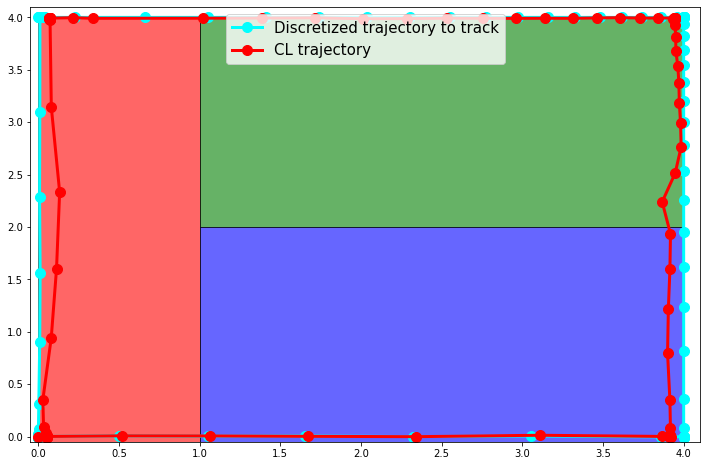

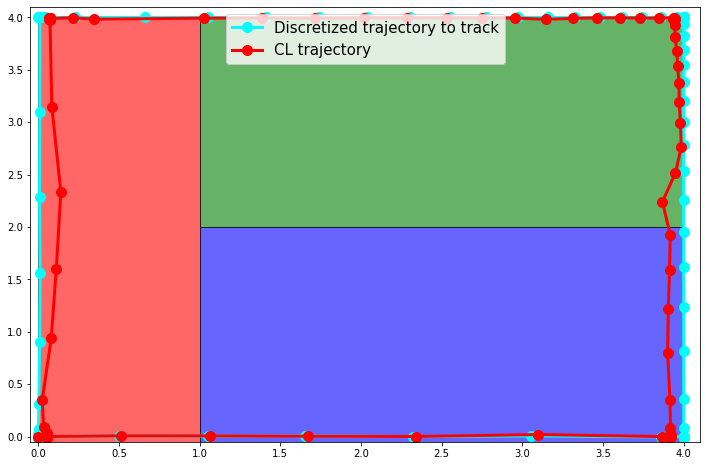

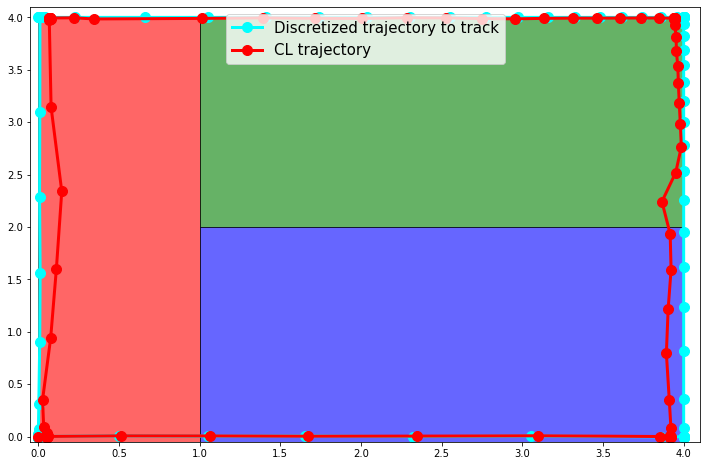

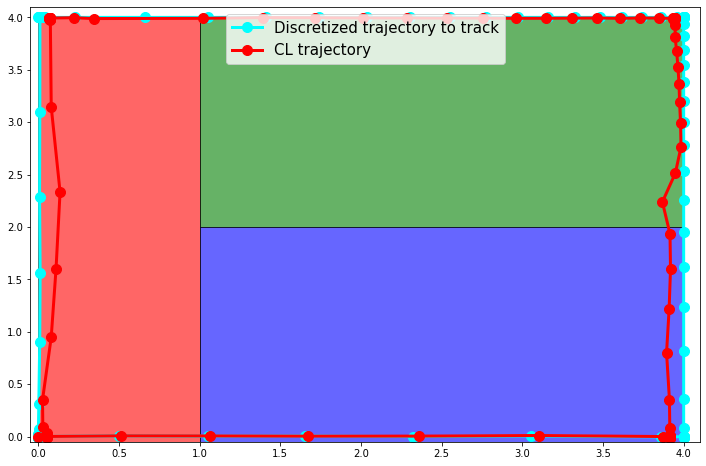

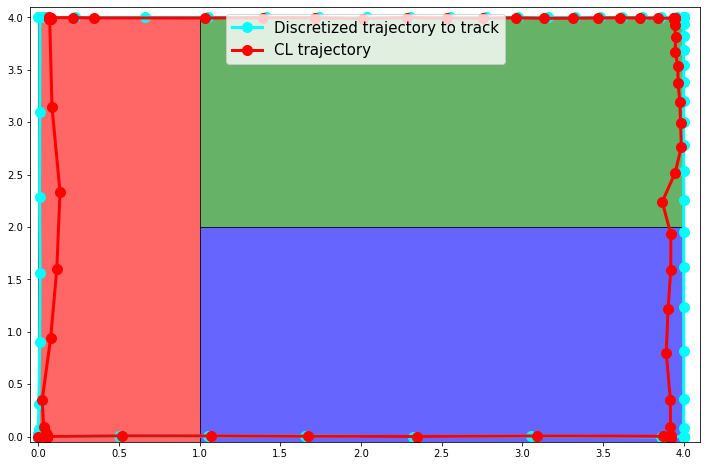

...

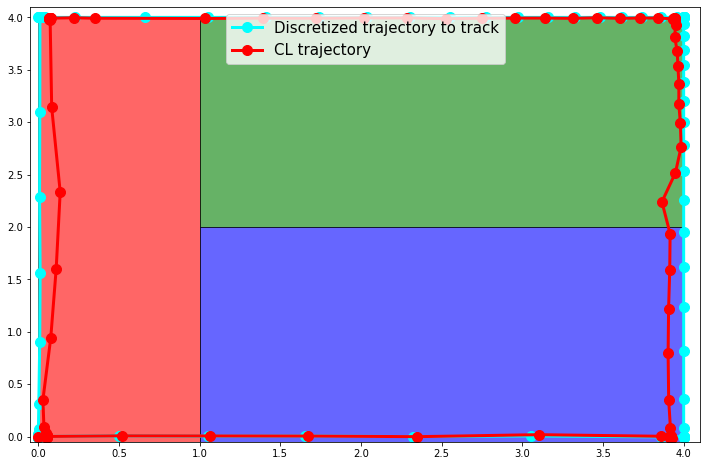

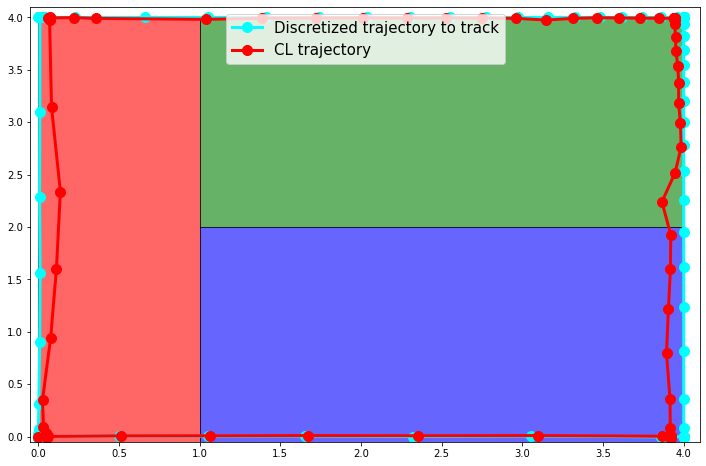

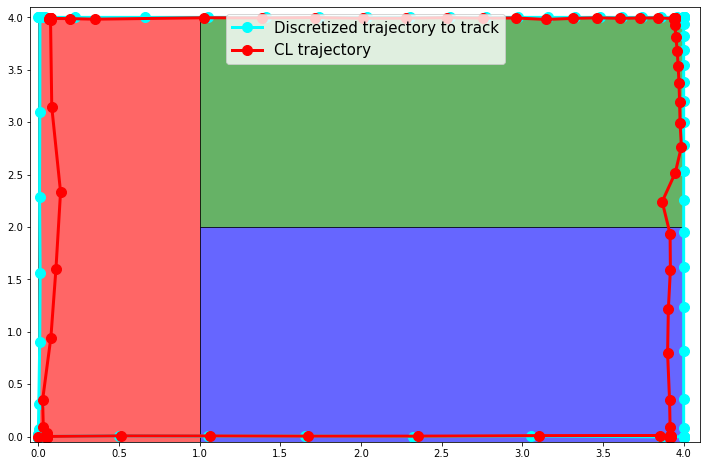

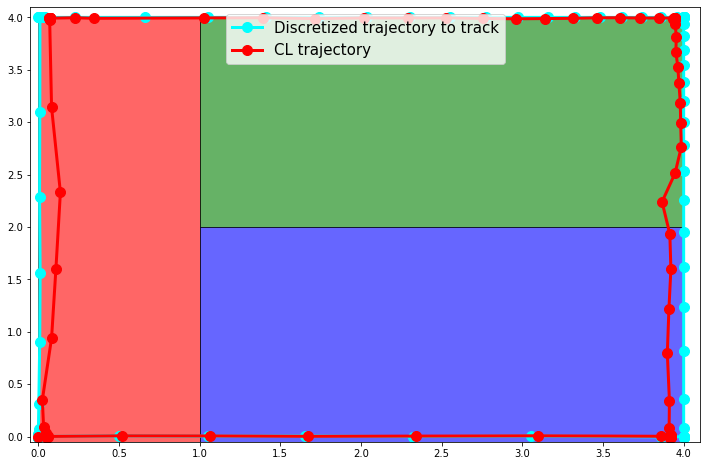

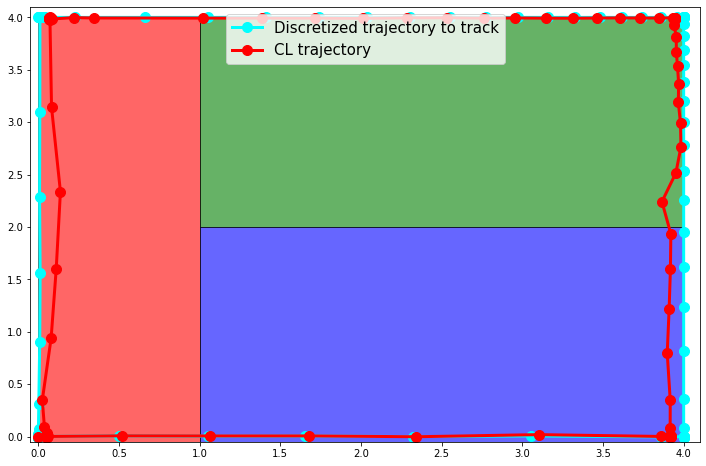

In [58]:
examples.gpmpc_QP_controller_multiple(satisfaction_prob=0.99,gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=30, data_save_file="final_QP_lti_runs_dt100msN100disc100xz4_edgetrack_px99")

### px = 0.9

[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
Shrinking by desired. MAKE SURE YOU HAVE PASSED IN THE MOST UP TO DATE X_DESIRED. This approach is to be used AFTER hlds have been generated since the hlds are used to forward
129
Solving for timestep: 0
t: 0, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [4.33814 0.06802] Solving for timestep: 1
t: 1, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 4.15328 -0.04531] Solving for timestep: 2
t: 2, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.82771 0.05131] Solving for timestep: 3
t: 3, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.82405 -0.03893] Solving for timestep: 4
t: 4, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [3.86849 0.0275 ] Solving for timestep: 5
t: 5, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [ 3.43074 -0.04437] Solving for timestep: 6
t: 6, Ret. stat.: Solved_To_Acceptable_Level, System inputs: [-4.06045  0.00251] Solving for timestep: 7
t: 7, Ret. stat.: So

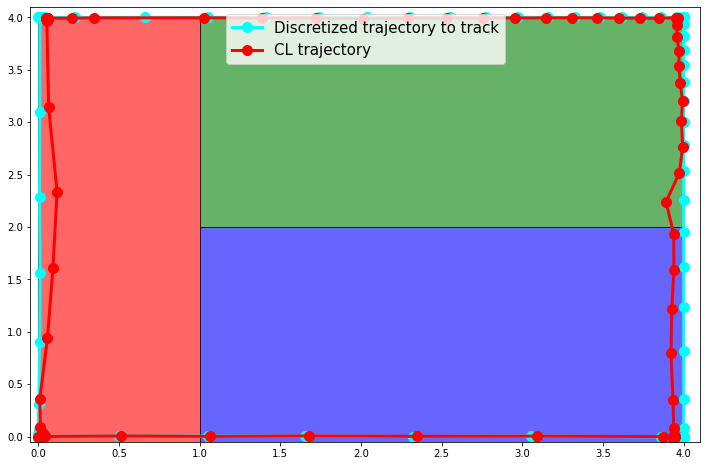

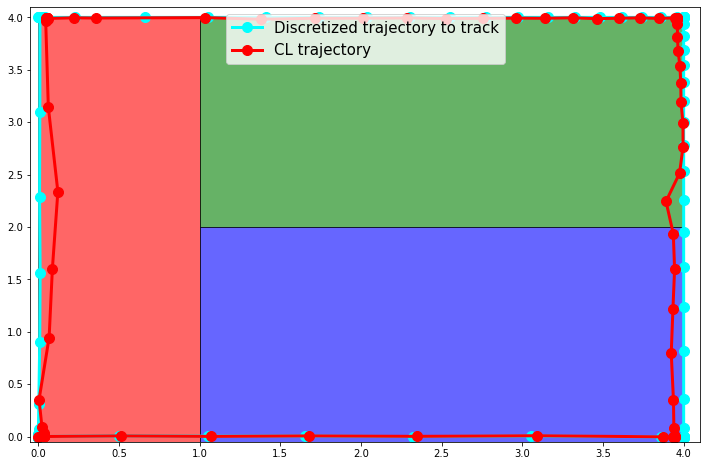

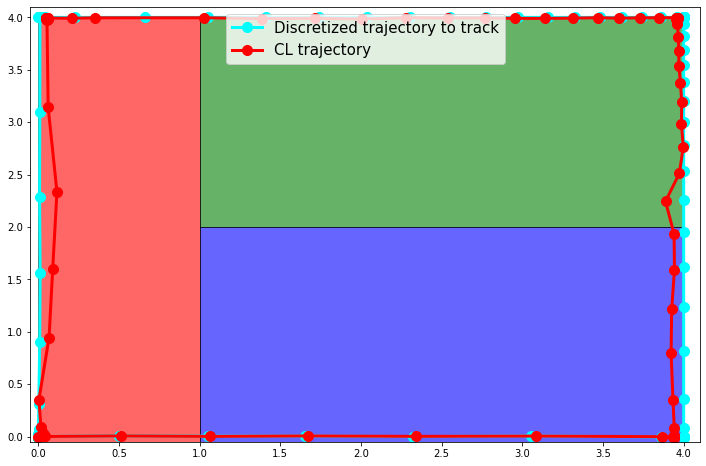

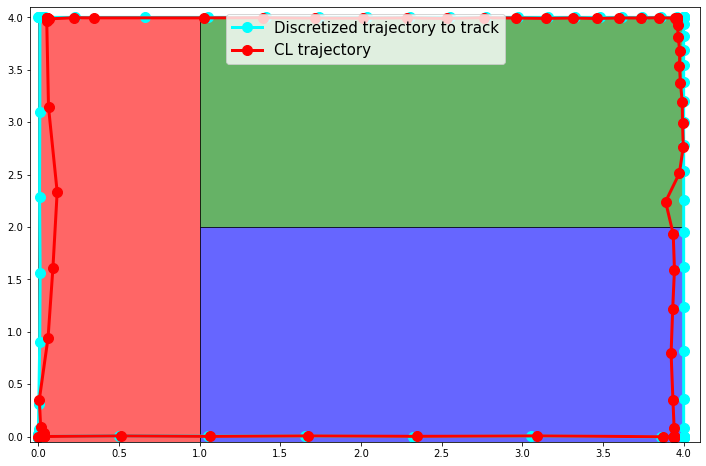

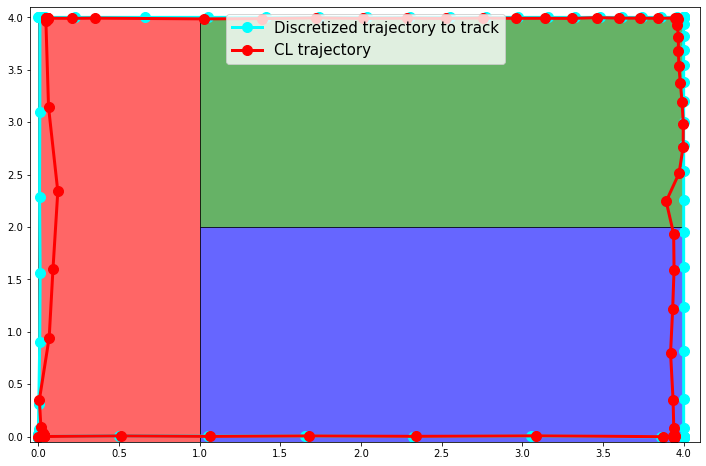

...

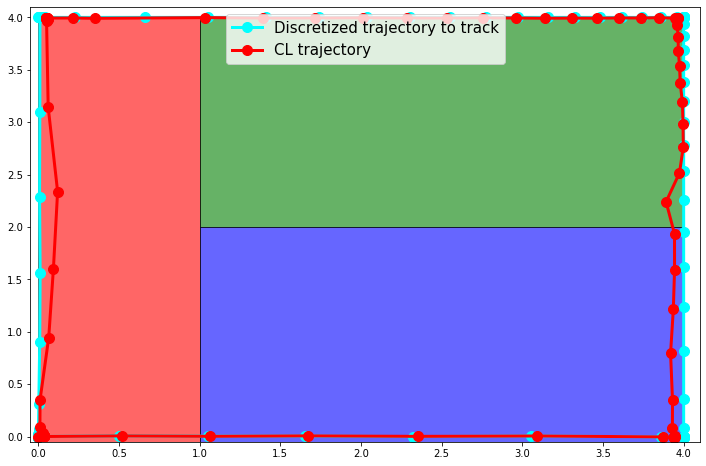

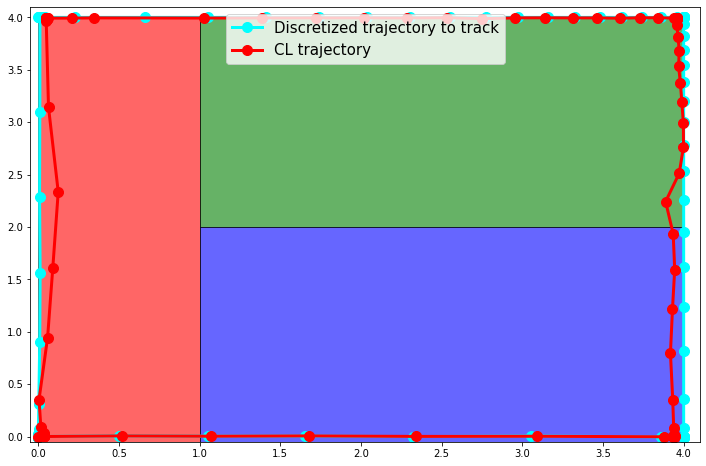

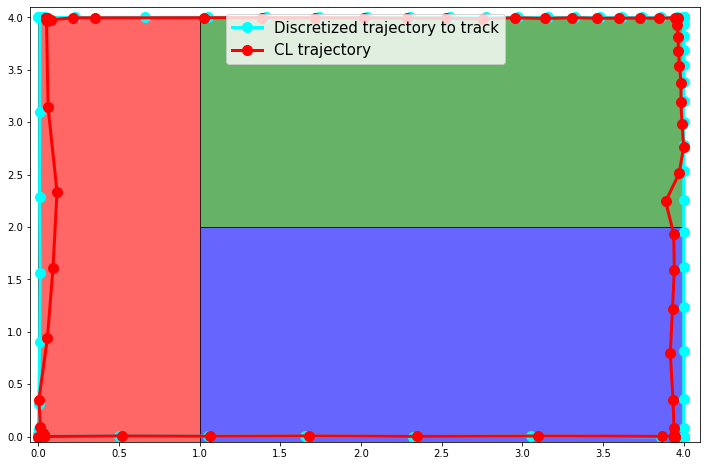

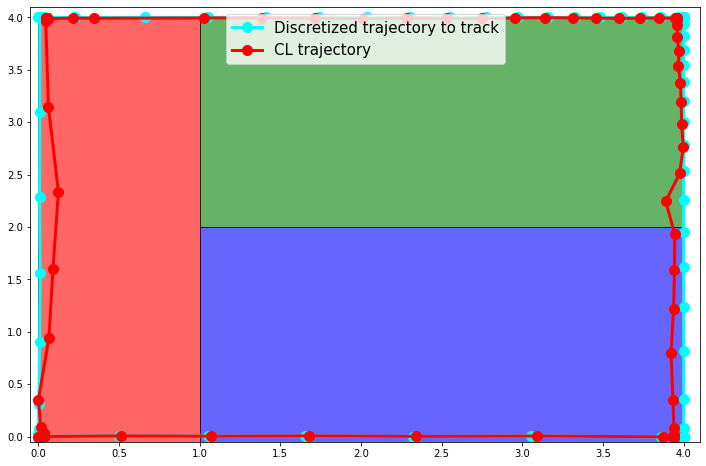

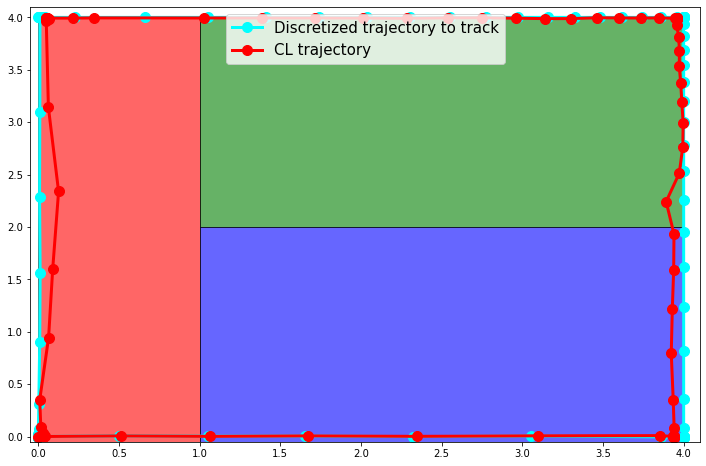

In [59]:
examples.gpmpc_QP_controller_multiple(satisfaction_prob=0.9,gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, fwd_sim="w_pw_res", true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, include_res_in_ctrl=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=30, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=30, data_save_file="final_QP_lti_runs_dt100msN100disc100xz4_edgetrack_px9")

## MINLP controller + shrinking (parametrized) controller

### px = 0.99

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
[[ 0.       0.5      1.05     1.655    2.3205   3.05255  3.8578   4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       3.96113  3.85725  3.74297  3.61727  3.479    3.3269   3.15958
   2.97554  2.7731   2.55041  2.30545  2.03599  1.73959  1.41355  1.05491
   0.6604   0.22644  0.04273  0.02208  0.01506  0.01241  0.00779  0.00598
   0.01193  0.01418  0.01331  0.00084  0.00455  0.00742  0.00624  0.00683
   0.00694  0.01042  0.00964  0.0081   0.01167  0.00908  0.00375  0.00196
   0.00099  0.00054  0.00036  0.00025  0.00007  0.00003  0.00001  0.
   0.       0.       0.       0.       0.       0.       0.       0.
   0.00015  0.00005  0.00002  0.00001  0.       0.       0.       0.
   0.   

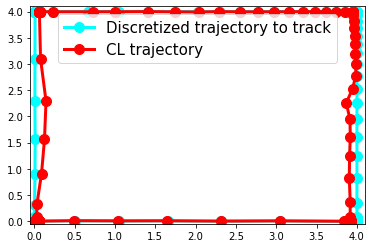

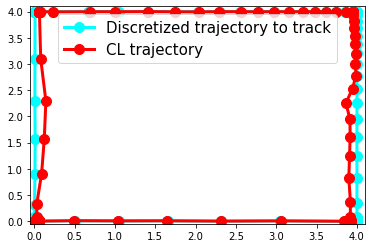

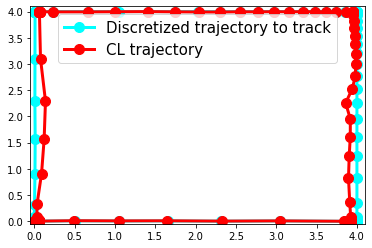

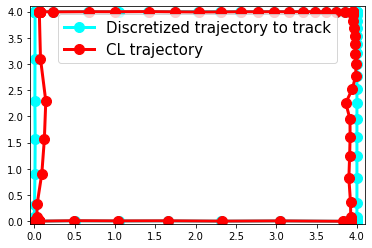

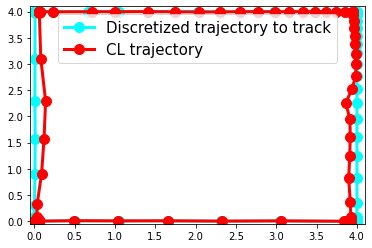

...

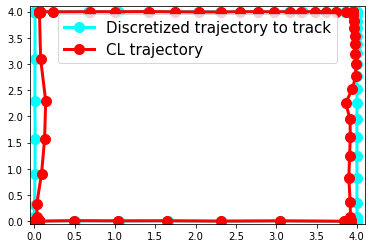

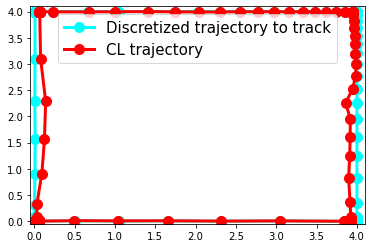

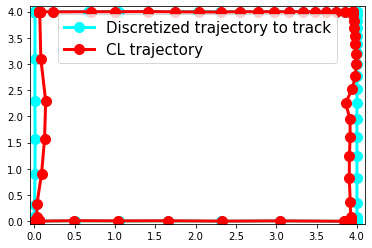

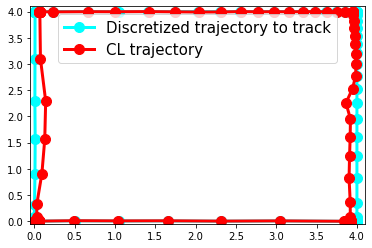

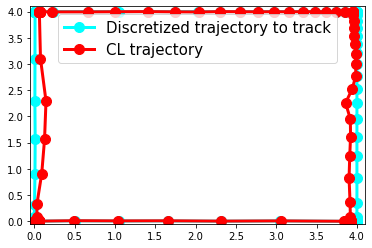

In [60]:
minlp_examples.gpmpc_MINLP_controller_C_multiple(satisfaction_prob=0.99, gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0, periodic_callback_freq=1,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=6, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=30, data_save_file="final_MINLP_lti_runs_dt100msN100disc100xz4_edgetrack_px99")

### px = 0.9

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
[[ 0.       0.5      1.05     1.655    2.3205   3.05255  3.8578   4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       3.96113  3.85725  3.74297  3.61727  3.479    3.3269   3.15958
   2.97554  2.7731   2.55041  2.30545  2.03599  1.73959  1.41355  1.05491
   0.6604   0.22644  0.04273  0.02208  0.01506  0.01241  0.00779  0.00598
   0.01193  0.01418  0.01331  0.00084  0.00455  0.00742  0.00624  0.00683
   0.00694  0.01042  0.00964  0.0081   0.01167  0.00908  0.00375  0.00196
   0.00099  0.00054  0.00036  0.00025  0.00007  0.00003  0.00001  0.
   0.       0.       0.       0.       0.       0.       0.       0.
   0.00015  0.00005  0.00002  0.00001  0.       0.       0.       0.
   0.   


KeyboardInterrupt



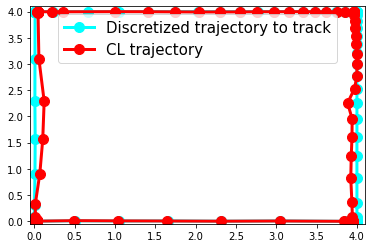

Error in callback <function flush_figures at 0x000002198A89D0D0> (for post_execute):



KeyboardInterrupt



In [61]:
minlp_examples.gpmpc_MINLP_controller_C_multiple(satisfaction_prob=0.9, gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0, periodic_callback_freq=1,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=6, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=30, data_save_file="final_MINLP_lti_runs_dt100msN100disc100xz4_edgetrack_px9")

[[0 1 0 0]]
[[1]
 [0]]
[[0 1 0 0]]
[[1]
 [0]]
NOT SKIPPING SHRINKING.
[[ 0.       0.5      1.05     1.655    2.3205   3.05255  3.8578   4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       4.       4.       4.       4.       4.       4.       4.
   4.       3.96113  3.85725  3.74297  3.61727  3.479    3.3269   3.15958
   2.97554  2.7731   2.55041  2.30545  2.03599  1.73959  1.41355  1.05491
   0.6604   0.22644  0.04273  0.02208  0.01506  0.01241  0.00779  0.00598
   0.01193  0.01418  0.01331  0.00084  0.00455  0.00742  0.00624  0.00683
   0.00694  0.01042  0.00964  0.0081   0.01167  0.00908  0.00375  0.00196
   0.00099  0.00054  0.00036  0.00025  0.00007  0.00003  0.00001  0.
   0.       0.       0.       0.       0.       0.       0.       0.
   0.00015  0.00005  0.00002  0.00001  0.       0.       0.       0.
   0.   

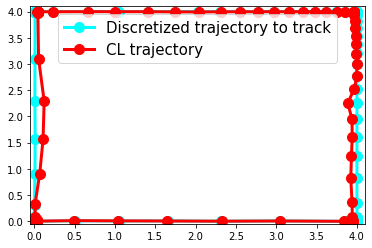

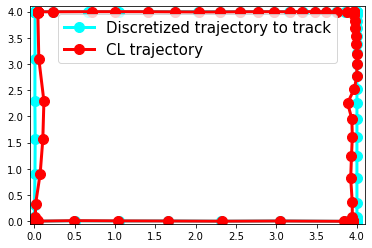

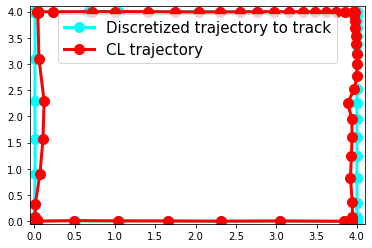

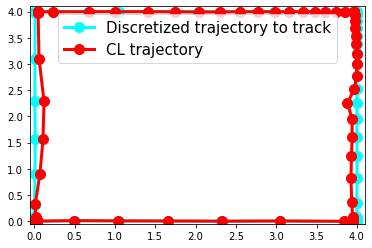

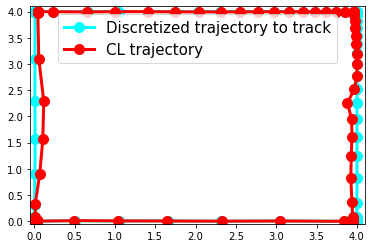

In [64]:
minlp_examples.gpmpc_MINLP_controller_C_multiple(satisfaction_prob=0.9, gp_fns=pw_gp_wrapped, x_init=np.zeros((2, 1)), N=100, closed_loop=True,
                             num_discrete=100, simulation_length=100, velocity_override=7, add_delta_constraints=False, true_ds_inst=ds_inst_in,
                             ignore_init_constr_check=True, collision_check=True, plot_shrunk_sets=False, plot_shrunk_sep=False,
                             early_termination=True, verbose=False, sampling_time=100 * 1e-3,
                             x_threshold=4, z_threshold=4, x0_delim=1, x1_delim=2, x_min_threshold=0, periodic_callback_freq=1,
                             waypoint_arr=((6, 0), (6, 6), (0, 6), (0, 0)), simulation_length_override=None,
                             problem_setup_fn=problem_setups.planar_lti_1d_inp_res, track_gen_fn=nlsys_utils.test_planar_lti_track,
                             integration_method='exact', online_N=6, read_desired_from_file="lti_dt100msN100disc100xz4_edgetrack",
                             Q_override=Q_override, R_override=R_override, num_multiple=5, data_save_file="final_MINLP_lti_runs_dt100msN100disc100xz4_edgetrack_px9")

## Results

In [44]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_B_lti_runs_dt100msN100disc100xz4_edgetrack"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(np.mean([run_data["collision_count"] for run_data in data]))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))

30
32.166666666666664
32.68510480935529
0.16276175546718644


In [45]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_D_lti_runs_dt100msN100disc100xz4_edgetrack_px99"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(data[-1]["collision_count"]/len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))

30
0.0
46.86758630416036
0.17318336130875056


In [46]:
import pickle as pkl
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_D_lti_runs_dt100msN100disc100xz4_edgetrack_px9"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(data[-1]["collision_count"]/len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))

30
1.4
39.35806583529311
0.09823124924574746


In [47]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_QP_lti_runs_dt100msN100disc100xz4_edgetrack_px99"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(data[-1]["collision_count"]/len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))

30
0.0
50.22753591490995
0.22354927109893738


In [48]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_QP_lti_runs_dt100msN100disc100xz4_edgetrack_px9"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(data[-1]["collision_count"]/len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))

30
0.1
42.489168592361416
0.11960925362555822


In [49]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_MINLP_lti_runs_dt100msN100disc100xz4_edgetrack_px99"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(data[-1]["collision_count"]/len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))

30
0.0
43.42287772187556
0.11222654728992293


In [50]:
with open("C:\\Users\\l8souza\\PycharmProjects\\GPMPC_HM\\src\\data_dir\\"+"final_MINLP_lti_runs_dt100msN100disc100xz4_edgetrack_px9"+".pkl", 'rb') as f:
    data = pkl.load(f)
print(len(data))
print(data[-1]["collision_count"]/len(data))
print(np.mean([run_data["cl_cost"] for run_data in data]))
print(np.std([run_data["cl_cost"] for run_data in data]))

40
0.05
36.355072194953756
1.633556808718676


# GP Training

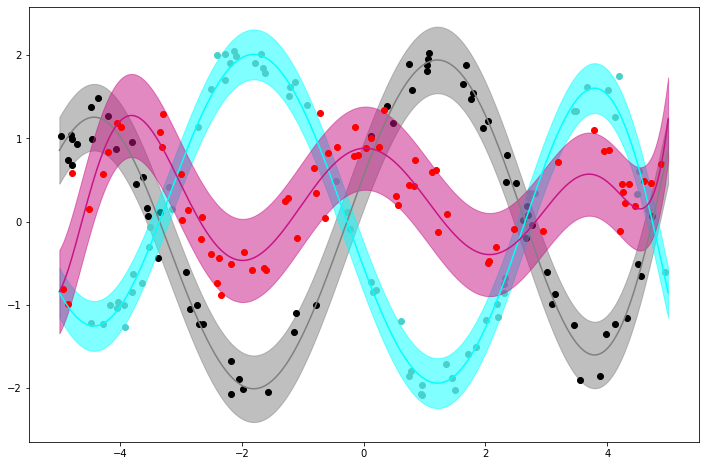

In [17]:
velocity_override = 5
setup_inst = problem_setups.quad_2d_sys_1d_inp_res(velocity_override)
regions = setup_inst["regions"]
s_start_limit, s_end_limit = setup_inst["x_start_limit"], setup_inst["x_end_limit"]
gp_input_mask = setup_inst["gp_input_mask"]
delta_input_mask = setup_inst["delta_input_mask"]
n_u = setup_inst["n_u"]
num_samples = 200
viz = True
noise_std_devs = [0.05, 0.07, 0.02]
scale_poly = 1
noise_std_devs = [0.1, 0.075, 0.125]
# noise_std_devs = [0.1, 0.075, 0.125]
scale_poly = 4
noise_std_devs = [0.2, 0.15, 0.25]

# 0 idx is np.polynomial.polynomial.polyfromroots([-0.2, -0.05, 0, 0.2]), 1 idx is np.polynomial.polynomial.polyfromroots([-0.25, -0.05, 0.15, 0.23])
poly_coeffs = [np.array([0.0075, -0.0425, -0.2   ,  1.][::-1])*5, 
               np.array([0.04, -0.22, -0.1 ,  1.    ][::-1])*5, np.array([4.3125e-04,  5.6000e-03, -6.7000e-02, -8.0000e-02,  1.0000e+00][::-1])*5]
poly_coeffs = [np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
               -np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
               np.array([3.48167424e-05,  2.29572396e-05, -1.92304178e-03, -5.29264039e-04,  3.35480619e-02,  5.82899495e-04, -1.87669116e-01,  9.30450457e-03,  2.20458632e-01])]
# poly_coeffs = [[1, 0, 0], [7, 0, 0]]

ds_inst_in = ds_utils.test_1d_op_1d_inp_poly(regions=regions, poly_coeffs=poly_coeffs,
                                             start_limit=setup_inst["gpinp_subset_lim_lb"], end_limit=setup_inst["gpinp_subset_lim_ub"], gp_input_mask=gp_input_mask,
                                             delta_input_mask=delta_input_mask, n_u=n_u, num_points=num_samples,
                                             noise_vars=[noise_std_dev ** 2 for noise_std_dev in noise_std_devs],
                                             no_viz=not viz, fineness_param=(200,), scale_poly=scale_poly)

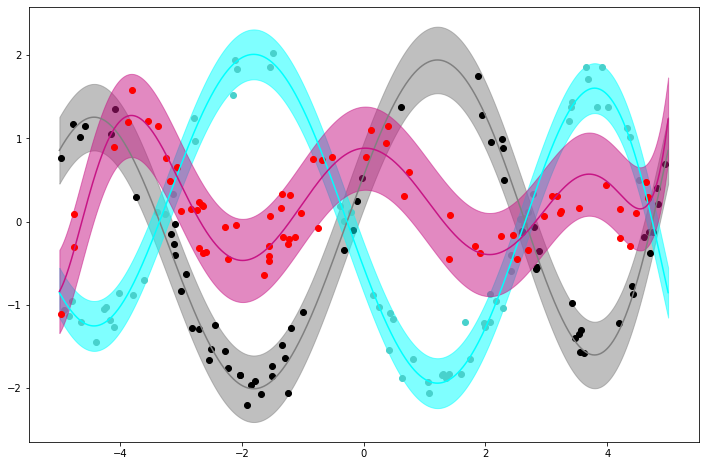

In [15]:
velocity_override = 5
setup_inst = problem_setups.quad_2d_sys_1d_inp_res(velocity_override)
regions = setup_inst["regions"]
s_start_limit, s_end_limit = setup_inst["x_start_limit"], setup_inst["x_end_limit"]
gp_input_mask = setup_inst["gp_input_mask"]
delta_input_mask = setup_inst["delta_input_mask"]
n_u = setup_inst["n_u"]
num_samples = 200
viz = True
noise_std_devs = [0.05, 0.07, 0.02]
scale_poly = 1
noise_std_devs = [0.1, 0.075, 0.125]
# noise_std_devs = [0.1, 0.075, 0.125]
scale_poly = 4
noise_std_devs = [0.2, 0.15, 0.25]

# 0 idx is np.polynomial.polynomial.polyfromroots([-0.2, -0.05, 0, 0.2]), 1 idx is np.polynomial.polynomial.polyfromroots([-0.25, -0.05, 0.15, 0.23])
poly_coeffs = [np.array([0.0075, -0.0425, -0.2   ,  1.][::-1])*5, 
               np.array([0.04, -0.22, -0.1 ,  1.    ][::-1])*5, np.array([4.3125e-04,  5.6000e-03, -6.7000e-02, -8.0000e-02,  1.0000e+00][::-1])*5]
poly_coeffs = [np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
               -np.array([-5.86024026e-05, -9.09922063e-05,  4.17839279e-03,  5.46798390e-03, -8.74124645e-02, -7.68274967e-02,  4.89430419e-01,  1.38718238e-01]),
               np.array([3.48167424e-05,  2.29572396e-05, -1.92304178e-03, -5.29264039e-04,  3.35480619e-02,  5.82899495e-04, -1.87669116e-01,  9.30450457e-03,  2.20458632e-01])]
# poly_coeffs = [[1, 0, 0], [7, 0, 0]]

ds_inst_in = ds_utils.test_1d_op_1d_inp_poly(regions=regions, poly_coeffs=poly_coeffs,
                                             start_limit=setup_inst["gpinp_subset_lim_lb"], end_limit=setup_inst["gpinp_subset_lim_ub"], gp_input_mask=gp_input_mask,
                                             delta_input_mask=delta_input_mask, n_u=n_u, num_points=num_samples,
                                             noise_vars=[noise_std_dev ** 2 for noise_std_dev in noise_std_devs],
                                             no_viz=not viz, fineness_param=(200,), scale_poly=scale_poly)

Training piecewise GP
Training model: 1 for region: 1


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:01<00:00, 253.62it/s]


final loss: 0.180291548371315, lengthscale: 1.55939 noise variance (sigma**2): 0.04088, noise std dev (sigma): 0.20220
Training model: 1 for region: 2


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:01<00:00, 260.80it/s]


final loss: 0.0432714968919754, lengthscale: 1.32211 noise variance (sigma**2): 0.02980, noise std dev (sigma): 0.17263
Training model: 1 for region: 3


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:01<00:00, 264.18it/s]


final loss: 0.3388558030128479, lengthscale: 0.84908 noise variance (sigma**2): 0.06583, noise std dev (sigma): 0.25658


C:\Users\l8souza\PycharmProjects\GPMPC_HM\src\models\utils.py:219: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matricesor `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at  C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:2318.)
  i_dim_labels = train_y[idx, :].T
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 350/350 [00:01<00:00, 205.69it/s]


final loss: 1.4307595491409302, lengthscale: 0.71997 noise variance (sigma**2): 0.95489, noise std dev (sigma): 0.97718
Training global GP


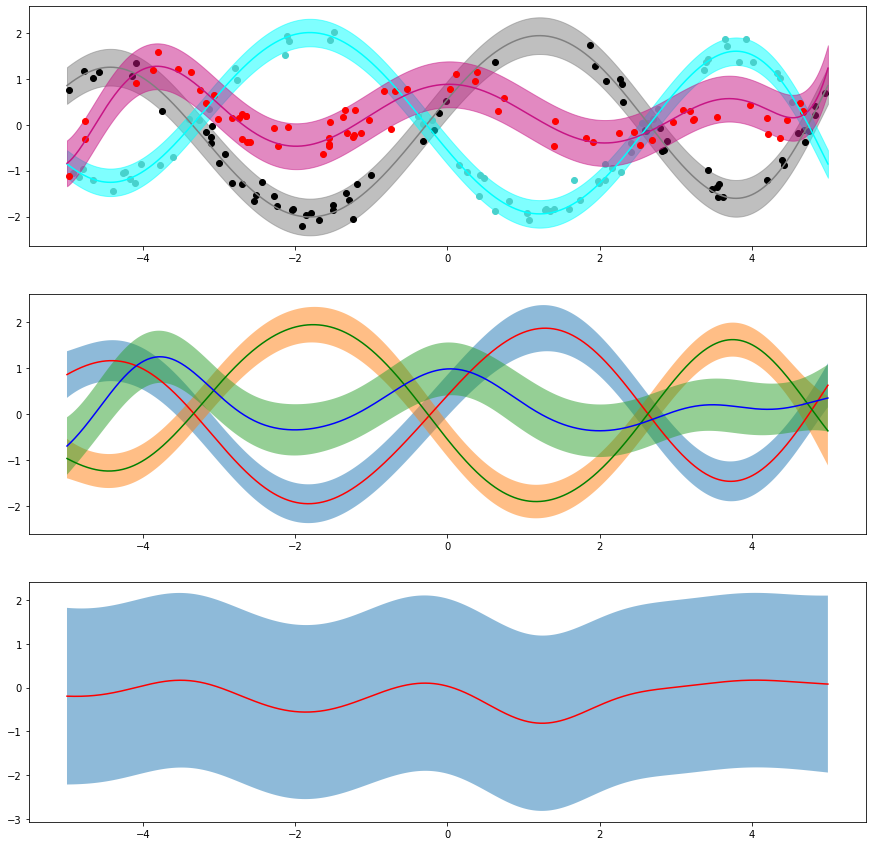

In [16]:
trained_gp_viz = True
train_verbose = True
return_error_attrs = False
seed = None
fineness_param = (75,)
num_iter = 350
true_only = False
terminate_by_change = False
save_to_file = False
load_from_file = False
file_save_name = "res_1d_poly_gp"
file_load_name = "res_1d_poly_gp"

pw_gp_wrapped, global_gp_wrapped, gp_ds_inst = gp_wrappers.train_global_n_pw(ds_inst_in, regions, viz=trained_gp_viz, verbose=train_verbose, return_error_attrs=return_error_attrs,
                                                                             seed=seed, fineness_param=fineness_param, num_iter=num_iter, true_only=true_only,
                                                                             terminate_by_change=terminate_by_change, save_to_file=save_to_file, load_from_file=load_from_file,
                                                                             file_save_name=file_save_name, file_load_name=file_load_name)

Training piecewise GP
Training model: 1 for region: 1


 ... (more hidden) ...


final loss: 0.15782830119132996, lengthscale: 1.34688 noise variance (sigma**2): 0.03777, noise std dev (sigma): 0.19434
Training model: 1 for region: 2


 ... (more hidden) ...


final loss: 0.006386901251971722, lengthscale: 1.35565 noise variance (sigma**2): 0.02631, noise std dev (sigma): 0.16220
Training model: 1 for region: 3


 ... (more hidden) ...


final loss: 0.5142651200294495, lengthscale: 0.82096 noise variance (sigma**2): 0.09665, noise std dev (sigma): 0.31089


 ... (more hidden) ...


final loss: 1.5247700214385986, lengthscale: 5.00377 noise variance (sigma**2): 1.22696, noise std dev (sigma): 1.10768
Training global GP


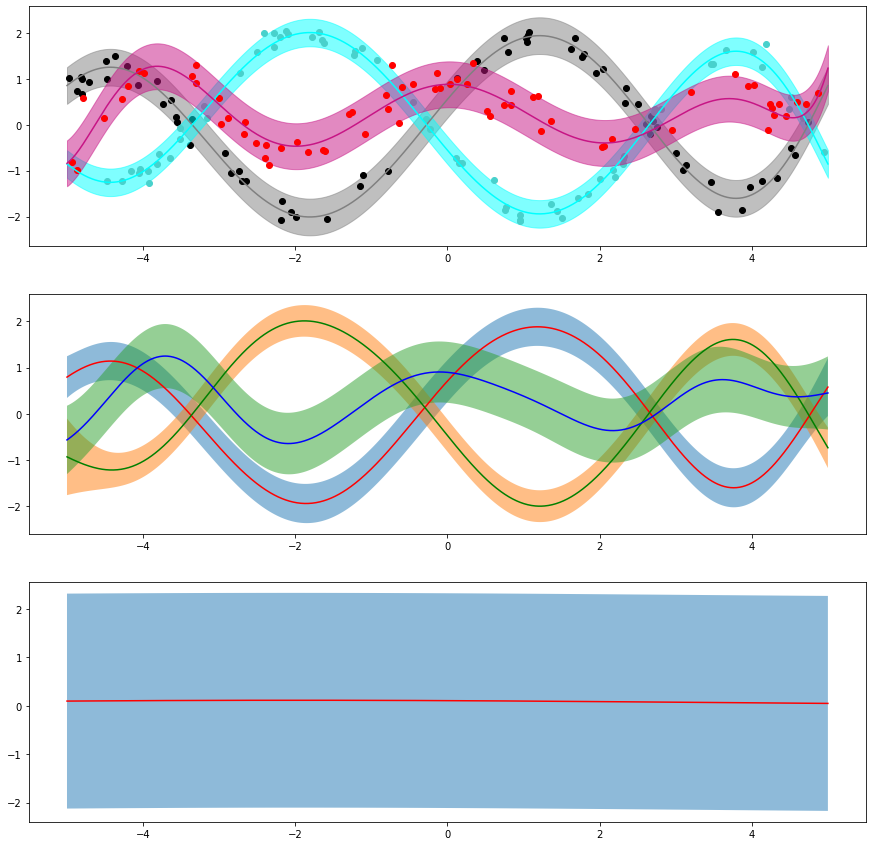

In [18]:
trained_gp_viz = True
train_verbose = True
return_error_attrs = False
seed = None
fineness_param = (75,)
num_iter = 350
true_only = False
terminate_by_change = False
save_to_file = False
load_from_file = False
file_save_name = "res_1d_poly_gp"
file_load_name = "res_1d_poly_gp"

pw_gp_wrapped, global_gp_wrapped, gp_ds_inst = gp_wrappers.train_global_n_pw(ds_inst_in, regions, viz=trained_gp_viz, verbose=train_verbose, return_error_attrs=return_error_attrs,
                                                                             seed=seed, fineness_param=fineness_param, num_iter=num_iter, true_only=true_only,
                                                                             terminate_by_change=terminate_by_change, save_to_file=save_to_file, load_from_file=load_from_file,
                                                                             file_save_name=file_save_name, file_load_name=file_load_name)